___

<p style="text-align: center;"><img src="https://docs.google.com/uc?id=1lY0Uj5R04yMY3-ZppPWxqCr5pvBLYPnV" class="img-fluid" alt="CLRSWY"></p>

___

# WELCOME!

## Introduction
Welcome to "***AutoScout Data Analysis Project***". This is the capstone project of ***Data Analysis*** Module. **Auto Scout** data which using for this project, scraped from the on-line car trading company in 2019, contains many features of 9 different car models. In this project, you will have the opportunity to apply many commonly used algorithms for Data Cleaning and Exploratory Data Analysis by using many Python libraries such as Numpy, Pandas, Matplotlib, Seaborn, Scipy you will analyze clean dataset.

The project consists of 3 parts:
* First part is related with 'data cleaning'. It deals with Incorrect Headers, Incorrect Format, Anomalies, Dropping useless columns.
* Second part is related with 'filling data'. It deals with Missing Values. Categorical to numeric transformation is done.
* Third part is related with 'handling outliers of data' via Visualisation libraries. Some insights are extracted.


# PART- 1 `( Data Cleaning )`

In [1]:
# Libraries
import numpy as np
import pandas as pd
from scipy import misc
import scipy
import json

# Display options
# pd.set_option('display.max_rows', 3000)
# pd.set_option('display.max_columns', 500)
# pd.set_option('display.max_info_rows', 3000)
# pd.set_option('display.max_info_columns', 500)
# pd.set_option('display.max_colwidth', 500)
# pd.set_option('display.expand_frame_repr', True)
# pd.set_option('display.width', 3000)

# # Visualisation
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
from collections import Counter
import warnings
warnings.filterwarnings('ignore') 

# # SQL
# import pyodbc
# import pandas.io.sql

# # Datetime
from datetime import datetime
now = datetime.now() # current date and time

In [2]:
df = pd.read_json("scout_car.json",lines=True,orient='columns')
df1 = df.copy()

In [3]:
df4 = pd.read_excel("ScoutCarV4ModelCode.xls")
df4.head(1)

WARNING *** OLE2 inconsistency: SSCS size is 0 but SSAT size is non-zero


,ID,Model_Code
0,0,0588/BDF


In [4]:
df1["Model Code"] = df4["Model_Code"]

In [5]:
df1.head(1)

,url,make_model,short_description,body_type,price,vat,km,registration,prev_owner,kW,...,description,Emission Label,Gears,Country version,Electricity consumption,Last Service Date,Other Fuel Types,Availability,Last Timing Belt Service Date,Available from
0,https://www.autoscout24.com//offers/audi-a1-sp...,Audi A1,Sportback 1.4 TDI S-tronic Xenon Navi Klima,Sedans,15770,VAT deductible,"56,013 km",01/2016,2 previous owners,NaN,...,"[\n, Sicherheit:, , Deaktivierung für Beifahr...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
df1.tail(1)

,url,make_model,short_description,body_type,price,vat,km,registration,prev_owner,kW,...,description,Emission Label,Gears,Country version,Electricity consumption,Last Service Date,Other Fuel Types,Availability,Last Timing Belt Service Date,Available from
15918,https://www.autoscout24.com//offers/renault-es...,Renault Espace,INITIALE PARIS TCe 225 EDC GPF NAVI SHZ AUX,Van,40999,VAT deductible,- km,01/2019,1 previous owner,NaN,...,"[\n, Sicherheit Airbags:, , Seitenairbag, , ...",[\n4 (Green)\n],NaN,[\nGermany\n],NaN,NaN,NaN,NaN,NaN,NaN


In [7]:
df1.sample(3).T

,7574,13090,14016
url,https://www.autoscout24.com//offers/opel-astra...,https://www.autoscout24.com//offers/renault-cl...,https://www.autoscout24.com//offers/renault-cl...
make_model,Opel Astra,Renault Clio,Renault Clio
short_description,"K 1.4 T Dynamic/Navi/PDC/16""/AGR",IV 1.2 TCe 120 EDC Intens Automatik wenig k,"1.5 dCi 90CV EDC Moschino Zen , NUOVA DA IMMAT..."
body_type,Sedans,Other,Sedans
price,13750,15990,18200
vat,VAT deductible,VAT deductible,VAT deductible
km,"19,840 km","5,711 km",10 km
registration,06/2018,08/2018,06/2019
prev_owner,1 previous owner,None,None
kW,NaN,NaN,NaN


In [8]:
df1.columns

Index(['url', 'make_model', 'short_description', 'body_type', 'price', 'vat',
       'km', 'registration', 'prev_owner', 'kW', 'hp', 'Type',
       'Previous Owners', 'Next Inspection', 'Inspection new', 'Warranty',
       'Full Service', 'Non-smoking Vehicle', 'null', 'Make', 'Model',
       'Offer Number', 'First Registration', 'Body Color', 'Paint Type',
       'Body Color Original', 'Upholstery', 'Body', 'Nr. of Doors',
       'Nr. of Seats', 'Model Code', 'Gearing Type', 'Displacement',
       'Cylinders', 'Weight', 'Drive chain', 'Fuel', 'Consumption',
       'CO2 Emission', 'Emission Class', '\nComfort & Convenience\n',
       '\nEntertainment & Media\n', '\nExtras\n', '\nSafety & Security\n',
       'description', 'Emission Label', 'Gears', 'Country version',
       'Electricity consumption', 'Last Service Date', 'Other Fuel Types',
       'Availability', 'Last Timing Belt Service Date', 'Available from'],
      dtype='object')

In [9]:
df1.shape

(15919, 54)

In [10]:
df1.size

859626

In [11]:
df1.describe()

,price,kW
count,15919.000000,0.0
mean,18019.896727,NaN
std,7386.169409,NaN
min,13.000000,NaN
25%,12850.000000,NaN
50%,16900.000000,NaN
75%,21900.000000,NaN
max,74600.000000,NaN


In [12]:
df1.describe(include = object).T

,count,unique,top,freq
url,15919,15919,https://www.autoscout24.com//offers/audi-a3-sp...,1
make_model,15919,9,Audi A3,3097
short_description,15873,10001,SPB 1.6 TDI 116 CV S tronic Sport,64
body_type,15859,9,Sedans,7903
vat,11406,2,VAT deductible,10980
km,15919,6690,10 km,1045
registration,15919,48,-/-,1597
prev_owner,9091,4,1 previous owner,8294
hp,15919,81,85 kW,2542
Type,15917,169,"[, Used, , Diesel (Particulate Filter)]",3475


In [13]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15919 entries, 0 to 15918
Data columns (total 54 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   url                            15919 non-null  object 
 1   make_model                     15919 non-null  object 
 2   short_description              15873 non-null  object 
 3   body_type                      15859 non-null  object 
 4   price                          15919 non-null  int64  
 5   vat                            11406 non-null  object 
 6   km                             15919 non-null  object 
 7   registration                   15919 non-null  object 
 8   prev_owner                     9091 non-null   object 
 9   kW                             0 non-null      float64
 10  hp                             15919 non-null  object 
 11  Type                           15917 non-null  object 
 12  Previous Owners                9279 non-null  

In [14]:
dtypes = pd.DataFrame(df1.dtypes, columns = ['dtypes'])
dtypes

,dtypes
url,object
make_model,object
short_description,object
body_type,object
price,int64
vat,object
km,object
registration,object
prev_owner,object
kW,float64


In [15]:
notnull = pd.DataFrame(df1.notnull().sum(), columns = ['notnull'])
notnull

,notnull
url,15919
make_model,15919
short_description,15873
body_type,15859
price,15919
vat,11406
km,15919
registration,15919
prev_owner,9091
kW,0


In [16]:
isnull = pd.DataFrame(df1.isnull().sum(), columns = ['isnull'])
isnull

,isnull
url,0
make_model,0
short_description,46
body_type,60
price,0
vat,4513
km,0
registration,0
prev_owner,6828
kW,15919


In [17]:
percentage_null = round(pd.DataFrame(df1.isnull().sum()/df.shape[0]*100, columns = ['percentage_null']))
percentage_null

,percentage_null
url,0.0
make_model,0.0
short_description,0.0
body_type,0.0
price,0.0
vat,28.0
km,0.0
registration,0.0
prev_owner,43.0
kW,100.0


In [18]:
df1_summary = pd.concat([dtypes, notnull, isnull, percentage_null], axis = 1).reset_index().rename({'index':'Columns'},axis = 1)
df1_summary

,Columns,dtypes,notnull,isnull,percentage_null
0,url,object,15919,0,0.0
1,make_model,object,15919,0,0.0
2,short_description,object,15873,46,0.0
3,body_type,object,15859,60,0.0
4,price,int64,15919,0,0.0
5,vat,object,11406,4513,28.0
6,km,object,15919,0,0.0
7,registration,object,15919,0,0.0
8,prev_owner,object,9091,6828,43.0
9,kW,float64,0,15919,100.0


# COLUMN-0 url (DROP)

'url' column will be dropped since all values are unique and cannot be used for price estimation.

In [19]:
df1['url'].head(5)

0    https://www.autoscout24.com//offers/audi-a1-sp...
1    https://www.autoscout24.com//offers/audi-a1-1-...
2    https://www.autoscout24.com//offers/audi-a1-sp...
3    https://www.autoscout24.com//offers/audi-a1-1-...
4    https://www.autoscout24.com//offers/audi-a1-sp...
Name: url, dtype: object

In [20]:
df1['url'][0]

'https://www.autoscout24.com//offers/audi-a1-sportback-1-4-tdi-s-tronic-xenon-navi-klima-diesel-black-bdab349a-caa5-41b0-98eb-c1345b84445e'

In [21]:
df1['url'].unique()

array(['https://www.autoscout24.com//offers/audi-a1-sportback-1-4-tdi-s-tronic-xenon-navi-klima-diesel-black-bdab349a-caa5-41b0-98eb-c1345b84445e',
       'https://www.autoscout24.com//offers/audi-a1-1-8-tfsi-sport-gasoline-red-b2547f8a-e83f-6237-e053-e250040a56df',
       'https://www.autoscout24.com//offers/audi-a1-sportback-1-6-tdi-s-tronic-einparkhilfe-plus-music-diesel-black-6183cb6a-8570-4b86-a132-9b54214bca88',
       ...,
       'https://www.autoscout24.com//offers/renault-espace-blue-dci-200-edc-initiale-paris-leder-led-navi-key-diesel-white-6256d1a3-ea68-4193-91de-b5b5ffa4631c',
       'https://www.autoscout24.com//offers/renault-espace-blue-dci-200cv-edc-business-nuova-da-immatricola-diesel-grey-5b0251a1-bd88-475c-a039-7e499da85d9d',
       'https://www.autoscout24.com//offers/renault-espace-initiale-paris-tce-225-edc-gpf-navi-shz-aux-gasoline-grey-0bd690d9-7e93-4cab-bc5a-9d5b63402481'],
      dtype=object)

In [22]:
df1['url'].nunique()

15919

# COLUMN-1 make_model (KEEP)

Although this column (make_model) seems clear; nevertheless, we will make a decision in accordance with the columns of 19 "Make" and 20 "Model". Probably we will decide to maintain these 3 columns in case we need "Make" and "Model" seperately for further analysis. 

In [23]:
# (1) make_model, (19) Make ve (20) Model sütunları içerikleri örtüştüğünden bu 3 sütunu beraber inceleyeceğiz.

In [24]:
df1.make_model.unique()

array(['Audi A1', 'Audi A2', 'Audi A3', 'Opel Astra', 'Opel Corsa',
       'Opel Insignia', 'Renault Clio', 'Renault Duster',
       'Renault Espace'], dtype=object)

In [25]:
df1.make_model.nunique()

9

In [26]:
df1.make_model.value_counts(dropna=False)

Audi A3           3097
Audi A1           2614
Opel Insignia     2598
Opel Astra        2526
Opel Corsa        2219
Renault Clio      1839
Renault Espace     991
Renault Duster      34
Audi A2              1
Name: make_model, dtype: int64

In [27]:
df1.make_model.isnull().sum()

0

# COLUMN-19 Make (DROP)

It is examined together with the (1) 'make_model' column. It will be dropped because it contains the same information.

In [28]:
df.Make

0           \nAudi\n
1           \nAudi\n
2           \nAudi\n
3           \nAudi\n
4           \nAudi\n
            ...     
15914    \nRenault\n
15915    \nRenault\n
15916    \nRenault\n
15917    \nRenault\n
15918    \nRenault\n
Name: Make, Length: 15919, dtype: object

In [29]:
df1['Make'] = df1['Make'].map(lambda x : x.strip('\n '), na_action = 'ignore')
df1['Make']

0           Audi
1           Audi
2           Audi
3           Audi
4           Audi
          ...   
15914    Renault
15915    Renault
15916    Renault
15917    Renault
15918    Renault
Name: Make, Length: 15919, dtype: object

In [30]:
df1['Make'].value_counts(dropna=False)

Opel       7343
Audi       5712
Renault    2864
Name: Make, dtype: int64

In [31]:
df1['Make'].isnull().sum()

0

# COLUMN-20 Model (DROP)

It is examined together with the (1) 'make_model' column. It will be dropped because it contains the same information.

In [32]:
df1.Model

0            [\n, A1, \n]
1            [\n, A1, \n]
2            [\n, A1, \n]
3            [\n, A1, \n]
4            [\n, A1, \n]
               ...       
15914    [\n, Espace, \n]
15915    [\n, Espace, \n]
15916    [\n, Espace, \n]
15917    [\n, Espace, \n]
15918    [\n, Espace, \n]
Name: Model, Length: 15919, dtype: object

In [33]:
df1['Model'] = df1['Model'].map(lambda x : x[1], na_action = 'ignore')
df1['Model'] 

0            A1
1            A1
2            A1
3            A1
4            A1
          ...  
15914    Espace
15915    Espace
15916    Espace
15917    Espace
15918    Espace
Name: Model, Length: 15919, dtype: object

In [34]:
df1['Model'].value_counts(dropna=False)

A3          3097
A1          2614
Insignia    2598
Astra       2526
Corsa       2219
Clio        1839
Espace       991
Duster        34
A2             1
Name: Model, dtype: int64

In [35]:
df1['Model'].isnull().sum()

0

In [36]:
df1[['make_model', 'Make', 'Model']].sample(20)

,make_model,Make,Model
3030,Audi A3,Audi,A3
14272,Renault Clio,Renault,Clio
15644,Renault Espace,Renault,Espace
6239,Opel Astra,Opel,Astra
7656,Opel Astra,Opel,Astra
5142,Audi A3,Audi,A3
499,Audi A1,Audi,A1
7681,Opel Astra,Opel,Astra
12016,Opel Insignia,Opel,Insignia
8106,Opel Astra,Opel,Astra


In [37]:
df1[['make_model', 'Make', 'Model']].isnull().sum()

make_model    0
Make          0
Model         0
dtype: int64

# COLUMN-2 short_description (KEEP/DROP)

Since the information in each row of this column is included by other columns it will be dropped in the 2nd phase

In [38]:
# (44) Description ile beraber incelenecek.

In [39]:
df1.short_description

0              Sportback 1.4 TDI S-tronic Xenon Navi Klima
1                                           1.8 TFSI sport
2        Sportback 1.6 TDI S tronic Einparkhilfe plus+m...
3                                  1.4 TDi Design S tronic
4        Sportback 1.4 TDI S-Tronic S-Line Ext. admired...
                               ...                        
15914                Blue dCi 200CV EDC Executive 4Control
15915                  TCe 225 EDC GPF LIM Deluxe Pano,RFK
15916    Blue dCi 200 EDC Initiale Paris Leder LED Navi...
15917    Blue dCi 200CV EDC Business , NUOVA DA IMMATRI...
15918          INITIALE PARIS TCe 225 EDC GPF NAVI SHZ AUX
Name: short_description, Length: 15919, dtype: object

In [40]:
df1.short_description[0]

'Sportback 1.4 TDI S-tronic Xenon Navi Klima'

In [41]:
df1.url[0]

'https://www.autoscout24.com//offers/audi-a1-sportback-1-4-tdi-s-tronic-xenon-navi-klima-diesel-black-bdab349a-caa5-41b0-98eb-c1345b84445e'

In [42]:
df.short_description.unique()

array(['Sportback 1.4 TDI S-tronic Xenon Navi Klima', '1.8 TFSI sport',
       'Sportback 1.6 TDI S tronic Einparkhilfe plus+music', ...,
       'ELYSEE ENERGY dCi 160 EDC',
       'INITIALE Paris TCe 225 EDC GPF ACC EU6',
       'TCe 225 EDC GPF LIM Deluxe Pano,RFK'], dtype=object)

In [43]:
df.short_description.nunique()

10001

In [44]:
df.short_description.value_counts(dropna=False)

SPB 1.6 TDI 116 CV S tronic Sport                     64
NaN                                                   46
1.4 66kW (90CV) Selective                             40
MOVE KLIMA CD USB ALLWETTER BLUETOOTH                 38
SPB 30 TDI S tronic Business                          35
                                                      ..
Sportback S line 35 TFSI 150 tronic Euro6d-Temp (D     1
Sportback 1.6 TDI Navi Xenon ACC Pdc Alu               1
ST 1.6CDTI S&S Select                                  1
Limited Blue dCi 118 kW (160CV) EDC                    1
Sedan 30 TDI S tronic Sport                            1
Name: short_description, Length: 10002, dtype: int64

In [45]:
df.short_description.isnull().sum()

46

# COLUMN-44  description (DROP)
It was examined together with the (2) 'short_description' column. It will be dropped because it is considered that it cannot be used in price estimation.

In [46]:
df1['description']

0        [\n, Sicherheit:,  , Deaktivierung für Beifahr...
1        [\nLangstreckenfahrzeug daher die hohe Kilomet...
2        [\n, Fahrzeug-Nummer: AM-95365,  , Ehem. UPE 2...
3        [\nAudi A1: , - 1e eigenaar , - Perfecte staat...
4        [\n, Technik & Sicherheit:, Xenon plus, Klimaa...
                               ...                        
15914    [\nVettura visionabile nella sede in Via Roma ...
15915    [\nDach: Panorama-Glas-Schiebedach, Lackierung...
15916    [\n, Getriebe:,  Automatik, Technik:,  Bordcom...
15917    [\nDEK:[2691331], Renault Espace Blue dCi 200C...
15918    [\n, Sicherheit Airbags:,  , Seitenairbag,  , ...
Name: description, Length: 15919, dtype: object

In [47]:
df.description.value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


[]                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                      

In [48]:
df.description.isnull().sum()

0

# COLUMN-3 body_type (KEEP)

In [49]:
# (3) body_type ve (27) Body sütunlarını aynı bilgiyi içerdiğinden bu 2 sütunu beraber inceleyeceğiz.

In [50]:
df1['body_type'].unique()

array(['Sedans', 'Station wagon', 'Compact', 'Other', 'Coupe', 'Van',
       'Off-Road', 'Convertible', None, 'Transporter'], dtype=object)

In [51]:
df1.body_type.nunique()

9

In [52]:
df1.body_type.value_counts(dropna=False)

Sedans           7903
Station wagon    3553
Compact          3153
Van               783
Other             290
Transporter        88
NaN                60
Off-Road           56
Coupe              25
Convertible         8
Name: body_type, dtype: int64

In [53]:
df1.body_type.isnull().sum()

60

In [54]:
df1[['body_type', 'Body']].sample(20)

,body_type,Body
14828,Compact,"[\n, Compact, \n]"
8608,Sedans,"[\n, Sedans, \n]"
4624,Sedans,"[\n, Sedans, \n]"
9006,Compact,"[\n, Compact, \n]"
10180,Sedans,"[\n, Sedans, \n]"
8719,Sedans,"[\n, Sedans, \n]"
5299,Station wagon,"[\n, Station wagon, \n]"
14388,Sedans,"[\n, Sedans, \n]"
12770,Station wagon,"[\n, Station wagon, \n]"
13184,Compact,"[\n, Compact, \n]"


In [55]:
df1[['body_type', 'Body']].isnull().sum()

body_type    60
Body         60
dtype: int64

# COLUMN-27 BODY (DROP)

It was examined together with the (3) 'body_type' column. It will be dropped because it is considered that it cannot be used in price estimation.

In [56]:
df1['Body']

0        [\n, Sedans, \n]
1        [\n, Sedans, \n]
2        [\n, Sedans, \n]
3        [\n, Sedans, \n]
4        [\n, Sedans, \n]
               ...       
15914       [\n, Van, \n]
15915       [\n, Van, \n]
15916       [\n, Van, \n]
15917       [\n, Van, \n]
15918       [\n, Van, \n]
Name: Body, Length: 15919, dtype: object

In [57]:
df1['Body'][1][1]

'Sedans'

In [58]:
df1['Body'] = df1['Body'].map(lambda x : x[1], na_action = 'ignore')
df1['Body']

0        Sedans
1        Sedans
2        Sedans
3        Sedans
4        Sedans
          ...  
15914       Van
15915       Van
15916       Van
15917       Van
15918       Van
Name: Body, Length: 15919, dtype: object

In [59]:
df1['Body'].unique()

array(['Sedans', 'Station wagon', 'Compact', 'Other', 'Coupe', 'Van',
       'Off-Road', 'Convertible', nan, 'Transporter'], dtype=object)

In [60]:
df1['Body'].nunique()

9

In [61]:
df1['Body'].value_counts(dropna=False)

Sedans           7903
Station wagon    3553
Compact          3153
Van               783
Other             290
Transporter        88
NaN                60
Off-Road           56
Coupe              25
Convertible         8
Name: Body, dtype: int64

In [62]:
df1['Body'].isnull().sum()

60

# COLUMN-4 price (KEEP)

Target column

In [63]:
df1.price.unique()

array([15770, 14500, 14640, ..., 41390, 39885, 39875], dtype=int64)

In [64]:
df1.price.nunique()

2956

In [65]:
df1.price.value_counts(dropna=False)

14990    154
15990    151
10990    139
15900    106
17990    102
        ... 
31940      1
15540      1
21649      1
27790      1
34815      1
Name: price, Length: 2956, dtype: int64

In [66]:
df1.price.isnull().sum()

0

In [67]:
df1[df1.price == 'nan'].value_counts().sum()

0

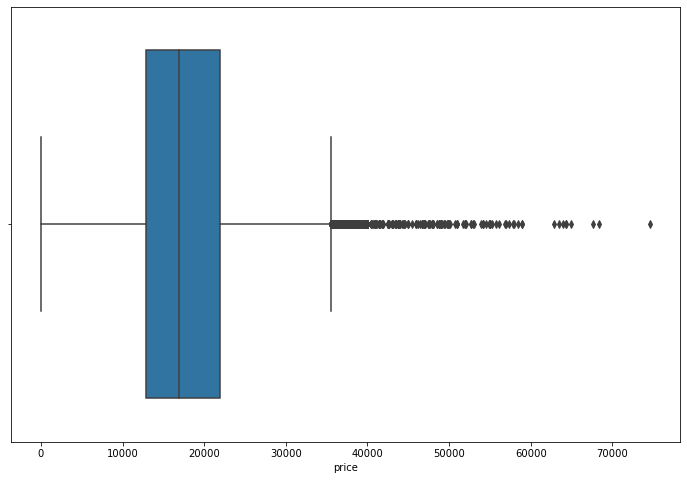

In [68]:
plt.figure(figsize=(12,8))

sns.boxplot(x = df1.price)

plt.show()

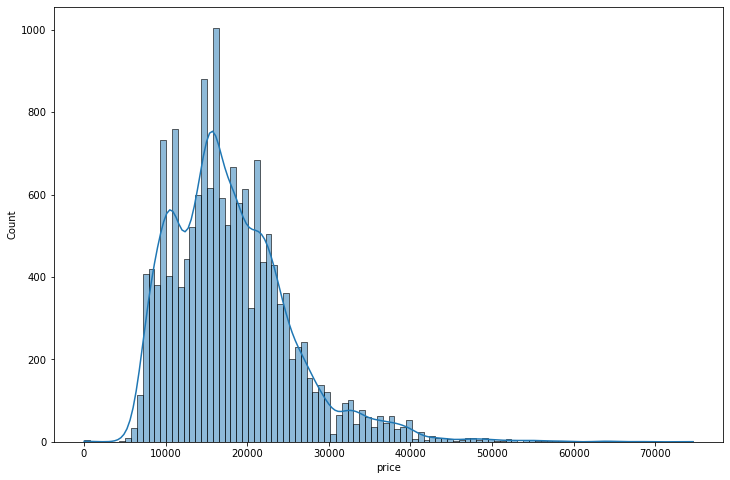

In [69]:
plt.figure(figsize=(12,8))

sns.histplot(x = df1.price, kde=True)

plt.show()

# COLUMN-5 vat (KEEP)

In [70]:
df1.vat.unique()

array(['VAT deductible', 'Price negotiable', None], dtype=object)

In [71]:
df1.vat.nunique()

2

In [72]:
df1.vat.value_counts(dropna=False)

VAT deductible      10980
NaN                  4513
Price negotiable      426
Name: vat, dtype: int64

In [73]:
df1.vat.isnull().sum()

4513

# COLUMN-6 km (KEEP)

In [74]:
df1.km.unique()

array(['56,013 km', '80,000 km', '83,450 km', ..., '2,864 km', '1,506 km',
       '57 km'], dtype=object)

In [75]:
df1.km.nunique()

6690

In [76]:
df1.km.value_counts(dropna=False)

10 km        1045
- km         1024
1 km          367
5 km          170
50 km         148
             ... 
7,880 km        1
3,916 km        1
50,054 km       1
9,522 km        1
25,570 km       1
Name: km, Length: 6690, dtype: int64

In [77]:
df1.km.isnull().sum()

0

In [78]:
df1[['km']]

,km
0,"56,013 km"
1,"80,000 km"
2,"83,450 km"
3,"73,000 km"
4,"16,200 km"
...,...
15914,- km
15915,"9,900 km"
15916,15 km
15917,10 km


In [79]:
df1.km.str.replace(',', "")

0        56013 km
1        80000 km
2        83450 km
3        73000 km
4        16200 km
           ...   
15914        - km
15915     9900 km
15916       15 km
15917       10 km
15918        - km
Name: km, Length: 15919, dtype: object

In [80]:
df1['km'] = df1.km.str.replace(',','').str.strip(' km').replace('-', np.nan).astype(float)
# df1.km.str.replace(',', "").str.extract('(\d+)').astype(float).head()

In [81]:
df1['km']

0        56013.0
1        80000.0
2        83450.0
3        73000.0
4        16200.0
          ...   
15914        NaN
15915     9900.0
15916       15.0
15917       10.0
15918        NaN
Name: km, Length: 15919, dtype: float64

In [82]:
df1['km'].value_counts(dropna=False)

10.0        1045
NaN         1024
1.0          367
5.0          170
50.0         148
            ... 
160542.0       1
20719.0        1
91910.0        1
39860.0        1
57889.0        1
Name: km, Length: 6690, dtype: int64

In [83]:
df1['km'].isnull().sum()

1024

# COLUMN-7 registration (KEEP)

The 'age' column was created using the 'registration' column'. It will be dropped at the end of the 2nd phase.

In [84]:
# (8)registration & (22)First Registration sütunları içerikleri örtüştüğünden bu 2 sütunu beraber inceleyeceğiz.

In [85]:
df1['registration'].head(1)

0    01/2016
Name: registration, dtype: object

In [86]:
df1['registration'].value_counts(dropna=False)

-/-        1597
03/2018     695
02/2019     585
05/2018     572
03/2019     543
01/2019     541
04/2018     541
02/2018     539
03/2016     536
04/2016     532
06/2018     532
01/2018     511
04/2019     506
02/2016     472
03/2017     471
05/2016     459
06/2016     452
05/2019     440
06/2017     409
05/2017     404
07/2018     396
04/2017     380
01/2016     376
02/2017     368
01/2017     306
08/2018     285
06/2019     224
07/2017     215
11/2017     180
07/2016     176
10/2016     160
10/2017     154
09/2017     149
11/2016     142
09/2018     141
09/2016     141
12/2016     134
12/2017     123
08/2017     114
11/2018     110
12/2018     103
10/2018      97
08/2016      94
07/2019       6
09/2019       5
12/2019       1
11/2019       1
08/2019       1
Name: registration, dtype: int64

In [87]:
df1['registration'].isnull().sum()

0

In [88]:
df1['registration'].map(lambda x: x[3:], na_action = 'ignore')

0        2016
1        2017
2        2016
3        2016
4        2016
         ... 
15914        
15915    2019
15916    2019
15917    2019
15918    2019
Name: registration, Length: 15919, dtype: object

In [89]:
df1['registration'] = df1['registration'].map(lambda x: x[3:], na_action = 'ignore')

In [90]:
df1['registration'] = pd.to_numeric(df1['registration'],errors = 'coerce')

In [91]:
df1['registration'].value_counts(dropna=False)

2018.0    4522
2016.0    3674
2017.0    3273
2019.0    2853
NaN       1597
Name: registration, dtype: int64

# COLUMN-22 First Registration (DROP)
It is examined together with the (7) 'registration' column. It will be dropped because it contains the same information.

In [92]:
df1['First Registration'].head(1)

0    [\n, 2016, \n]
Name: First Registration, dtype: object

In [93]:
df1['First Registration'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


[\n, 2018, \n]    4522
[\n, 2016, \n]    3674
[\n, 2017, \n]    3273
[\n, 2019, \n]    2853
NaN               1597
Name: First Registration, dtype: int64

In [94]:
df1['First Registration'].isnull().sum()

1597

In [95]:
df1['First Registration'].map(lambda x: float(x[1]), na_action = 'ignore')

0        2016.0
1        2017.0
2        2016.0
3        2016.0
4        2016.0
          ...  
15914       NaN
15915    2019.0
15916    2019.0
15917    2019.0
15918    2019.0
Name: First Registration, Length: 15919, dtype: float64

In [96]:
df1['First Registration'] = df1['First Registration'].map(lambda x: float(x[1]), na_action = 'ignore')

In [97]:
df1['First Registration'].value_counts(dropna=False)

2018.0    4522
2016.0    3674
2017.0    3273
2019.0    2853
NaN       1597
Name: First Registration, dtype: int64

In [98]:
df1['First Registration'].isnull().sum()

1597

In [99]:
# (8)registration & (22)First Registration sütunlarının karşılaştırılması

In [100]:
df1[['registration', 'First Registration']].isnull().sum()

registration          1597
First Registration    1597
dtype: int64

In [101]:
df1[['registration', 'First Registration']].sample(5)

,registration,First Registration
9173,2017.0,2017.0
15293,2016.0,2016.0
13387,2017.0,2017.0
4610,2019.0,2019.0
15095,2018.0,2018.0


In [102]:
df1[['registration', 'First Registration']].value_counts()

registration  First Registration
2018.0        2018.0                4522
2016.0        2016.0                3674
2017.0        2017.0                3273
2019.0        2019.0                2853
dtype: int64

# NEW COLUMN age

In [103]:
# 'registration' sütunu ile AGE hesaplanması

df1['age'] = 2019 - df1['registration']
df1['age']

0        3.0
1        2.0
2        3.0
3        3.0
4        3.0
        ... 
15914    NaN
15915    0.0
15916    0.0
15917    0.0
15918    0.0
Name: age, Length: 15919, dtype: float64

In [104]:
df1['age'].head(1)

0    3.0
Name: age, dtype: float64

In [105]:
df1['age'].value_counts(dropna=False)

1.0    4522
3.0    3674
2.0    3273
0.0    2853
NaN    1597
Name: age, dtype: int64

# COLUMN-8 prev_owner (KEEP)

In [106]:
# (9)prev_owner & (13)Previous Owners sütunları içerikleri örtüştüğünden bu 2 sütunu beraber inceleyeceğiz.

In [107]:
df1['prev_owner'].head(1)

0    2 previous owners
Name: prev_owner, dtype: object

In [108]:
df1['prev_owner'].value_counts(dropna=False)

1 previous owner     8294
NaN                  6828
2 previous owners     778
3 previous owners      17
4 previous owners       2
Name: prev_owner, dtype: int64

In [109]:
df1['prev_owner'].isnull().sum()

6828

In [110]:
df1['prev_owner'].str.strip('previous owners').astype(float)

0        2.0
1        NaN
2        1.0
3        1.0
4        1.0
        ... 
15914    NaN
15915    1.0
15916    1.0
15917    NaN
15918    1.0
Name: prev_owner, Length: 15919, dtype: float64

In [111]:
df1['prev_owner'] = df1.prev_owner.str.strip('previous owners').astype(float)

In [112]:
df1['prev_owner'].value_counts(dropna=False)

1.0    8294
NaN    6828
2.0     778
3.0      17
4.0       2
Name: prev_owner, dtype: int64

# COLUMN-12 Previous Owners (DROP)

It is examined together with the (8) 'prev_owner' column. It will be dropped because it contains the same information.

In [113]:
df1['Previous Owners'].head(1)

0    \n2\n
Name: Previous Owners, dtype: object

In [114]:
df1['Previous Owners'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


\n1\n                                                                                        8101
NaN                                                                                          6640
\n2\n                                                                                         766
\n0\n                                                                                         163
\n3\n                                                                                          17
                                                                                             ... 
[\n1\n, \n134 g CO2/km (comb)\n]                                                                1
[\n1\n, \n, 6 l/100 km (comb), \n, 8 l/100 km (city), \n, 4.9 l/100 km (country), \n]           1
[\n0\n, \n, 4.6 l/100 km (comb), \n, 5.8 l/100 km (city), \n, 3.9 l/100 km (country), \n]       1
[\n1\n, \n, 6.6 l/100 km (comb), \n, 8.1 l/100 km (city), \n, 5.7 l/100 km (country), \n]       1
[\n1\n, \n102 g CO2/

In [115]:
df1['Previous Owners'].isnull().sum()

6640

In [116]:
df1['Previous Owners'].str.strip('\n').astype(float)

0        2.0
1        NaN
2        1.0
3        1.0
4        1.0
        ... 
15914    NaN
15915    NaN
15916    NaN
15917    NaN
15918    1.0
Name: Previous Owners, Length: 15919, dtype: float64

In [117]:
df1['Previous Owners'] = df1['Previous Owners'].str.strip('\n').astype(float)

In [118]:
df1['Previous Owners'].value_counts(dropna=False)

1.0    8101
NaN    6870
2.0     766
0.0     163
3.0      17
4.0       2
Name: Previous Owners, dtype: int64

In [119]:
# 'prev_owner' ve 'Previous Owners' sütunlarının karşılaştırılması

In [120]:
df1[['prev_owner', 'Previous Owners']].isnull().sum()

prev_owner         6828
Previous Owners    6870
dtype: int64

In [121]:
df1[['prev_owner', 'Previous Owners', 'age']].sample(20)

,prev_owner,Previous Owners,age
14782,NaN,NaN,0.0
9517,1.0,1.0,1.0
3309,1.0,1.0,1.0
10760,NaN,NaN,2.0
4719,1.0,1.0,1.0
6047,1.0,1.0,3.0
6149,NaN,NaN,3.0
5312,NaN,NaN,0.0
7708,1.0,1.0,0.0
13964,NaN,NaN,2.0


In [122]:
# 'prev_owner' sütununda ISNULL olup 'Previous Owners' sütununda NOTNULL alan kontrolü 

pd.set_option('display.max_rows', None)
df1[(df1['prev_owner'].isnull()) & (df1['Previous Owners'].notnull())][['prev_owner','Previous Owners']].value_counts().sum()

0

In [123]:
# 'prev_owner' sütununda NOTNULL olup 'Previous Owners' sütununda ISNULL alan kontrolü 

pd.set_option('display.max_rows', None)
df1[(df1['prev_owner'].notnull()) & (df1['Previous Owners'].isnull())][['prev_owner','Previous Owners']].value_counts().sum()

0

In [124]:
# Düzenleme yapılıp her 2 sütundaki prevowner sayıları alındıktan sonra null değerlere bakıldığında 'prev_owner' 
# sütununun kullanılması daha uygun. Daha az null değer var. 
# 'Previous Owners' sütunu başka bir yerde kullanılmayacaksa DROP edilebilir.

# 'Previous Owners' sütununda 163 adet 0 değer mevcut. NEW için kullanılabilir.

In [125]:
df1[['prev_owner', 'Previous Owners']].value_counts()

prev_owner  Previous Owners
1.0         1.0                8101
2.0         2.0                 766
3.0         3.0                  17
4.0         4.0                   2
dtype: int64

In [126]:
df1.prev_owner.value_counts(dropna=False)

1.0    8294
NaN    6828
2.0     778
3.0      17
4.0       2
Name: prev_owner, dtype: int64

In [127]:
df1['Previous Owners'].value_counts(dropna=False)

1.0    8101
NaN    6870
2.0     766
0.0     163
3.0      17
4.0       2
Name: Previous Owners, dtype: int64

In [128]:
df1[['prev_owner', 'Previous Owners']].isnull().sum()

prev_owner         6828
Previous Owners    6870
dtype: int64

In [129]:
df1[(df1['prev_owner'].notnull()) != (df1['Previous Owners'].notnull())][['prev_owner', 'Previous Owners']]

,prev_owner,Previous Owners
47,NaN,0.0
418,NaN,0.0
586,NaN,0.0
648,NaN,0.0
734,NaN,0.0
743,NaN,0.0
869,NaN,0.0
980,NaN,0.0
1080,1.0,NaN
1097,1.0,NaN


In [130]:
# 'Previous Owners' sütunundaki 0.0 değerleri 'prev_owner' sütununa geçirilecek ve  'Previous Owners'  DROP edilecek

In [131]:
df1['prev_owner'].value_counts(dropna=False)

1.0    8294
NaN    6828
2.0     778
3.0      17
4.0       2
Name: prev_owner, dtype: int64

In [132]:
df1[(df1['prev_owner'].isnull()) & (df1['Previous Owners'] == 0.0)][['prev_owner', 'Previous Owners']]

,prev_owner,Previous Owners
47,NaN,0.0
418,NaN,0.0
586,NaN,0.0
648,NaN,0.0
734,NaN,0.0
743,NaN,0.0
869,NaN,0.0
980,NaN,0.0
1099,NaN,0.0
1194,NaN,0.0


In [133]:
# prev_owner değerleri NULL, Previous Owners değerleri 0.0 olan prev_owner sütunlarının 0.0 ile doldurulması

df1.loc[(df1['prev_owner'].isnull()) & (df1['Previous Owners'] == 0.0), 'prev_owner'] = 0

In [134]:
df1['prev_owner'].value_counts(dropna=False)

1.0    8294
NaN    6665
2.0     778
0.0     163
3.0      17
4.0       2
Name: prev_owner, dtype: int64

# COLUMN-9 kW (DROP)

It will be dropped as it does not contain any values ​​and all lines are blank.

In [135]:
df1['kW'].head(1)

0   NaN
Name: kW, dtype: float64

In [136]:
df1['kW'].isnull().sum()

15919

# COLUMN-10 hp (DROP)

The 'hp' column will be dropped, the newly created 'hp_kW' column will be used.

In [137]:
df1['hp'].head(1)

0    66 kW
Name: hp, dtype: object

In [138]:
df1['hp'].value_counts(dropna=False)

85 kW     2542
66 kW     2122
81 kW     1402
100 kW    1308
110 kW    1112
70 kW      888
125 kW     707
51 kW      695
55 kW      569
118 kW     516
92 kW      466
121 kW     392
147 kW     380
77 kW      345
56 kW      286
54 kW      276
103 kW     253
87 kW      232
165 kW     194
88 kW      177
60 kW      160
162 kW      98
- kW        88
74 kW       81
96 kW       72
71 kW       59
101 kW      47
67 kW       40
154 kW      39
122 kW      35
119 kW      30
164 kW      27
135 kW      24
52 kW       22
82 kW       22
78 kW       20
1 kW        20
146 kW      18
294 kW      18
141 kW      16
57 kW       10
120 kW       8
104 kW       8
191 kW       7
112 kW       7
155 kW       6
117 kW       6
184 kW       5
90 kW        4
65 kW        4
76 kW        4
93 kW        3
168 kW       3
149 kW       3
98 kW        3
80 kW        3
167 kW       2
228 kW       2
40 kW        2
127 kW       2
53 kW        2
86 kW        2
89 kW        2
150 kW       2
143 kW       2
140 kW       2
63 kW     

In [139]:
df1['hp'].isnull().sum()

0

# NEW COLUMN hp_kW (KEEP)

In [140]:
df1['hp_kW'] = df1['hp'].str.strip(' kW').replace('-', np.nan).astype(float)

In [141]:
df1['hp_kW']

0         66.0
1        141.0
2         85.0
3         66.0
4         66.0
5         85.0
6         85.0
7         66.0
8         85.0
9         70.0
10        85.0
11        92.0
12        92.0
13       112.0
14        70.0
15        85.0
16        85.0
17        66.0
18        70.0
19        85.0
20        85.0
21        92.0
22        92.0
23        85.0
24        70.0
25        70.0
26        70.0
27        70.0
28        66.0
29        70.0
30        66.0
31        66.0
32        70.0
33        66.0
34        66.0
35        70.0
36        70.0
37        66.0
38        60.0
39        66.0
40        60.0
41        66.0
42        66.0
43        66.0
44        66.0
45        70.0
46        66.0
47        85.0
48        60.0
49        60.0
50        66.0
51        70.0
52        70.0
53        85.0
54        66.0
55        70.0
56        60.0
57        70.0
58        66.0
59        70.0
60        66.0
61        70.0
62        70.0
63        85.0
64        66.0
65        71.0
66        

In [142]:
df1['hp_kW'].value_counts(dropna=False)

85.0     2542
66.0     2122
81.0     1402
100.0    1308
110.0    1112
70.0      888
125.0     707
51.0      695
55.0      569
118.0     516
92.0      466
121.0     392
147.0     380
77.0      345
56.0      286
54.0      276
103.0     253
87.0      232
165.0     194
88.0      177
60.0      160
162.0      98
NaN        88
74.0       81
96.0       72
71.0       59
101.0      47
67.0       40
154.0      39
122.0      35
119.0      30
164.0      27
135.0      24
82.0       22
52.0       22
1.0        20
78.0       20
146.0      18
294.0      18
141.0      16
57.0       10
120.0       8
104.0       8
191.0       7
112.0       7
155.0       6
117.0       6
184.0       5
90.0        4
76.0        4
65.0        4
149.0       3
98.0        3
93.0        3
80.0        3
168.0       3
150.0       2
63.0        2
140.0       2
86.0        2
89.0        2
40.0        2
167.0       2
53.0        2
228.0       2
127.0       2
143.0       2
270.0       2
9.0         1
44.0        1
123.0       1
195.0 

In [143]:
df1['hp_kW'].value_counts(dropna=False).index.sort_values()

Float64Index([  1.0,   4.0,   9.0,  40.0,  44.0,  51.0,  52.0,  53.0,  54.0,
               55.0,  56.0,  57.0,  60.0,  63.0,  65.0,  66.0,  67.0,  70.0,
               71.0,  74.0,  75.0,  76.0,  77.0,  78.0,  80.0,  81.0,  82.0,
               84.0,  85.0,  86.0,  87.0,  88.0,  89.0,  90.0,  92.0,  93.0,
               96.0,  98.0, 100.0, 101.0, 103.0, 104.0, 110.0, 112.0, 115.0,
              117.0, 118.0, 119.0, 120.0, 121.0, 122.0, 123.0, 125.0, 127.0,
              132.0, 133.0, 135.0, 137.0, 140.0, 141.0, 143.0, 146.0, 147.0,
              149.0, 150.0, 154.0, 155.0, 162.0, 163.0, 164.0, 165.0, 167.0,
              168.0, 184.0, 191.0, 195.0, 228.0, 239.0, 270.0, 294.0,   nan],
             dtype='float64')

# COLUMN-11 Type (DROP)
It will be dropped as the 'vehicle_condition' column is created using the 'type' column.

In [144]:
# (11) 'Type', (36) 'Fuel', (50) 'Other Fuel Types' sütunları benzer bilgiler içerdiğinden beraber incelenecek.

In [145]:
df1['Type'].head(1)  # Bu sütunda aracın durumu ile yakıt türü bilgileri mevcut.

0    [, Used, , Diesel (Particulate Filter)]
Name: Type, dtype: object

In [146]:
df1['Type'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


[, Used, , Diesel (Particulate Filter)]                                                                                                       3475
[, Used, , Diesel]                                                                                                                            2516
[, Used, , Gasoline]                                                                                                                          2367
[, Used, , Super 95]                                                                                                                          1818
[, Pre-registered, , Super 95]                                                                                                                 500
[, New, , Super 95]                                                                                                                            497
[, Employee's car, , Diesel (Particulate Filter)]                                                                     

In [147]:
df1['Type'].isnull().sum()

2

In [148]:
df1['Type'].map(lambda x : x[1], na_action = 'ignore')

0                  Used
1                  Used
2                  Used
3                  Used
4                  Used
5                  Used
6                  Used
7                  Used
8                  Used
9                  Used
10                 Used
11                 Used
12                 Used
13                 Used
14                 Used
15       Employee's car
16                 Used
17                 Used
18                 Used
19                 Used
20                 Used
21                 Used
22                 Used
23                 Used
24                 Used
25                 Used
26                 Used
27                 Used
28                 Used
29                 Used
30                 Used
31                 Used
32                 Used
33                 Used
34                 Used
35                 Used
36                 Used
37                 Used
38                 Used
39                 Used
40                 Used
41              

In [149]:
df1['Type'] = df1['Type'].map(lambda x : x[1], na_action = 'ignore')

In [150]:
df1['Type'].value_counts(dropna=False)

Used              11096
New                1650
Pre-registered     1364
Employee's car     1011
Demonstration       796
NaN                   2
Name: Type, dtype: int64

# COLUMN-36 Fuel (KEEP)

In [151]:
df1['Fuel'].head(1)

0    [\n, Diesel (Particulate Filter), \n]
Name: Fuel, dtype: object

In [152]:
df1['Fuel'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


[\n, Diesel (Particulate Filter), \n]                                                                                                       4315
[\n, Super 95, \n]                                                                                                                          3338
[\n, Gasoline, \n]                                                                                                                          3175
[\n, Diesel, \n]                                                                                                                            2984
[\n, Super 95 / Regular/Benzine 91, \n]                                                                                                      424
[\n, Regular/Benzine 91, \n]                                                                                                                 354
[\n, Super E10 95, \n]                                                                                                            

In [153]:
df1['Fuel'].isnull().sum()

0

In [154]:
df1['Fuel'].map(lambda x : x[1], na_action = 'ignore')

0                              Diesel (Particulate Filter)
1                                                 Gasoline
2                              Diesel (Particulate Filter)
3                              Diesel (Particulate Filter)
4                              Diesel (Particulate Filter)
5                              Diesel (Particulate Filter)
6                              Diesel (Particulate Filter)
7                              Diesel (Particulate Filter)
8                              Diesel (Particulate Filter)
9                                                 Gasoline
10                             Diesel (Particulate Filter)
11                                                Super 95
12                                      Regular/Benzine 91
13                                                Gasoline
14                                                Super 95
15                             Diesel (Particulate Filter)
16                                                  Dies

In [155]:
df1['Fuel'] = df1['Fuel'].map(lambda x : x[1], na_action = 'ignore')

In [156]:
df1['Fuel'].value_counts(dropna=False)

Diesel (Particulate Filter)                                                                                                       4315
Super 95                                                                                                                          3338
Gasoline                                                                                                                          3175
Diesel                                                                                                                            2984
Super 95 / Regular/Benzine 91                                                                                                      424
Regular/Benzine 91                                                                                                                 354
Super E10 95                                                                                                                       331
Super 95 (Particulate Filter)                          

In [157]:
df1['Fuel'].isnull().sum()

0

In [158]:
df1['Fuel'].unique()

array(['Diesel (Particulate Filter)', 'Gasoline', 'Super 95',
       'Regular/Benzine 91', 'Diesel',
       'Regular/Benzine 91 / Super Plus 98 / Regular/Benzine E10 91 / Super 95 / Super E10 95 / Super Plus E10 98',
       'Super E10 95', 'Super 95 (Particulate Filter)',
       'Super 95 / Regular/Benzine 91',
       'Super 95 / Super Plus 98 / Super E10 95 / Super Plus E10 98',
       'Super E10 95 / Super 95',
       'Super 95 / Regular/Benzine 91 / Super Plus 98',
       'Super 95 / Super Plus 98 / Super E10 95',
       'Super 95 / Super Plus 98',
       'Super 95 / Regular/Benzine 91 / Super E10 95 / Super Plus E10 98 / Super Plus 98 / Regular/Benzine E10 91',
       'Others', 'Super 95 / Super E10 95',
       'Gasoline (Particulate Filter)',
       'Regular/Benzine E10 91 / Regular/Benzine 91 / Super 95 / Super Plus 98 / Super E10 95 / Super Plus E10 98',
       'Super E10 95 / Super 95 / Super Plus 98 / Super Plus E10 98 (Particulate Filter)',
       'Regular/Benzine E10 91',
  

In [159]:
df1['Fuel'] = df1['Fuel'].str.replace('Super 95', 'Benzin')\
.str.replace('Electric/Gasoline', 'Hybrid')\
.str.replace('Electric', 'Hybrid')\
.str.replace('Gasoline', 'Benzin')\
.str.replace('Super Plus 98', 'Benzin')\
.str.replace('Regular/Benzine 91', 'Benzin')\
.str.replace('(Particulate Filter)','')\
.str.replace('Super E10 95','Benzin')\
.str.replace('/','')\
.str.replace('RegularBenzine E10 91','Benzin')\
.str.replace('Super Plus E10 98','Benzin')\
.str.replace('Liquid petroleum gas', 'LPG')\
.str.replace('Domestic gas H', 'LPG')\
.str.replace('CNG', 'LPG')\
.str.replace('Biogas', 'LPG')\
.str.replace('(','')\
.str.strip('() ')

In [160]:
df1['Fuel'].value_counts() # çift olan değerleri teke indirmek için set yapılabilir

Benzin                                            7669
Diesel                                            7299
Benzin  Benzin                                     735
Benzin  Benzin  Benzin  Benzin                      78
LPG                                                 54
Benzin  Benzin  Benzin  Benzin  Benzin  Benzin      38
Benzin  Benzin  Benzin                              23
LPG LPG                                             10
Others                                               6
Hybrid                                               5
Benzin  Biodiesel                                    1
Benzin  Benzin  Benzin  Benzin  Benzin               1
Name: Fuel, dtype: int64

In [161]:
df1['Fuel'] = df1['Fuel'].map(lambda x :list(set(x.split()))[0], na_action = 'ignore')

In [162]:
df1['Fuel'].value_counts(dropna=False)

Benzin    8545
Diesel    7299
LPG         64
Others       6
Hybrid       5
Name: Fuel, dtype: int64

# COLUMN-50  Other Fuel Types (DROP) 
It will be dropped as it does not contain any information.

In [163]:
df1['Other Fuel Types'].head(1)

0    NaN
Name: Other Fuel Types, dtype: object

In [164]:
df1['Other Fuel Types'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


NaN             15039
[[], [], []]      880
Name: Other Fuel Types, dtype: int64

In [165]:
df1['Other Fuel Types'].isnull().sum()

15039

In [166]:
# 'Type', 'Fuel', 'Other Fuel Types' sütunlarının karşılaştırılması

In [167]:
df1[['Type', 'Fuel', 'Other Fuel Types']].sample(20)

,Type,Fuel,Other Fuel Types
345,Used,Diesel,NaN
508,Used,Benzin,NaN
10362,Used,Benzin,NaN
9788,Pre-registered,Benzin,NaN
13199,Used,Benzin,NaN
5979,Used,Diesel,NaN
5527,New,Benzin,"[[], [], []]"
3533,Used,Diesel,NaN
15407,Used,Diesel,NaN
2749,Used,Diesel,NaN


In [168]:
df1[['Type', 'Fuel', 'Other Fuel Types']].isnull().sum()

Type                    2
Fuel                    0
Other Fuel Types    15039
dtype: int64

# NEW COLUMN vehicle_condition (KEEP)

NULL değerler dolduruldu. NULL değer yok.

In [169]:
df1['Type'].value_counts()

Used              11096
New                1650
Pre-registered     1364
Employee's car     1011
Demonstration       796
Name: Type, dtype: int64

In [170]:
df1['vehicle_condition'] = df1.Type

In [171]:
df1['vehicle_condition'].isnull().sum()

2

In [172]:
df1['vehicle_condition'].value_counts(dropna=False)

Used              11096
New                1650
Pre-registered     1364
Employee's car     1011
Demonstration       796
NaN                   2
Name: vehicle_condition, dtype: int64

# COLUMN-13 Next Inspection (DROP)
The 'Next Inspection_year' column was created from the 'Next Inspection' column. It will be dropped as it no longer needs to be used.

In [173]:
df1['Next Inspection'].head(1)

0    [\n06/2021\n, \n99 g CO2/km (comb)\n]
Name: Next Inspection, dtype: object

In [174]:
df1['Next Inspection'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


NaN                                                                                                12384
\n04/2022\n                                                                                           62
\n03/2021\n                                                                                           38
\n03/2022\n                                                                                           36
\n06/2021\n                                                                                           34
\n01/2022\n                                                                                           32
\n04/2021\n                                                                                           29
[\n06/2021\n, \nEuro 6\n]                                                                             29
[\n08/2021\n, \n135 g CO2/km (comb)\n]                                                                28
\n05/2021\n                                            

In [175]:
df1['Next Inspection'].isnull().sum()

12384

In [176]:
df1['Next Inspection'].head(10)

0    [\n06/2021\n, \n99 g CO2/km (comb)\n]
1                                      NaN
2                                      NaN
3                                      NaN
4                                      NaN
5                                      NaN
6                                      NaN
7                                      NaN
8    [\n02/2020\n, \n97 g CO2/km (comb)\n]
9                                      NaN
Name: Next Inspection, dtype: object

In [177]:
df1['Next Inspection'] = [item[0] if type(item) == list else item for item in df1['Next Inspection']]
df1['Next Inspection'].head(10)

0    \n06/2021\n
1            NaN
2            NaN
3            NaN
4            NaN
5            NaN
6            NaN
7            NaN
8    \n02/2020\n
9            NaN
Name: Next Inspection, dtype: object

In [178]:
df1['Next Inspection'] = df1['Next Inspection'].str.strip('\n')

In [179]:
df1['Next Inspection'].value_counts(dropna=False)

NaN        12384
06/2021      471
03/2021      210
05/2021      180
04/2021      171
02/2021      168
04/2022      144
05/2022      143
01/2021      132
03/2022      121
03/2020      113
02/2022      112
01/2022      107
02/2020       74
07/2021       68
04/2020       68
08/2021       64
01/2020       63
05/2020       62
06/2020       58
11/2020       58
12/2020       50
04/2019       50
05/2019       50
11/2021       49
07/2020       48
09/2021       46
07/2019       43
09/2019       41
06/2022       40
06/2019       40
10/2020       38
03/2019       36
11/2019       35
08/2020       35
08/2019       32
10/2019       32
02/2019       31
01/2019       28
09/2020       27
12/2021       22
12/2019       20
01/2023       20
10/2021       20
02/2023       12
03/2023       10
10/2018       10
07/2022        9
08/2022        8
12/2018        6
07/2018        5
01/2001        5
11/2018        4
04/2017        4
03/2017        4
06/2016        4
08/2018        3
04/2023        3
03/2018       

# NEW COLUMN Next Inspection_year (KEEP/DROP)
It will be dropped at the end of the 2nd phase.

In [180]:
# next inspection un yıl bölümünü çekerek yeni bir sütun oluşturuyoruz.

In [181]:
df1['Next Inspection'].map(lambda x: x[3:], na_action = 'ignore').astype(float)

0        2021.0
1           NaN
2           NaN
3           NaN
4           NaN
5           NaN
6           NaN
7           NaN
8        2020.0
9           NaN
10          NaN
11          NaN
12       2019.0
13          NaN
14       2019.0
15       2020.0
16          NaN
17          NaN
18       2020.0
19          NaN
20          NaN
21          NaN
22       2019.0
23          NaN
24          NaN
25          NaN
26          NaN
27          NaN
28          NaN
29          NaN
30          NaN
31       2019.0
32          NaN
33          NaN
34          NaN
35          NaN
36          NaN
37       2019.0
38       2019.0
39          NaN
40          NaN
41          NaN
42          NaN
43          NaN
44       2021.0
45       2019.0
46          NaN
47          NaN
48          NaN
49          NaN
50          NaN
51       2019.0
52          NaN
53          NaN
54          NaN
55       2020.0
56       2019.0
57       2021.0
58       2019.0
59          NaN
60          NaN
61          NaN
62      

In [182]:
df1['Next Inspection_year'] = df1['Next Inspection'].map(lambda x: x[3:], na_action = 'ignore').astype(float)

In [183]:
df1['Next Inspection_year'] 

0        2021.0
1           NaN
2           NaN
3           NaN
4           NaN
5           NaN
6           NaN
7           NaN
8        2020.0
9           NaN
10          NaN
11          NaN
12       2019.0
13          NaN
14       2019.0
15       2020.0
16          NaN
17          NaN
18       2020.0
19          NaN
20          NaN
21          NaN
22       2019.0
23          NaN
24          NaN
25          NaN
26          NaN
27          NaN
28          NaN
29          NaN
30          NaN
31       2019.0
32          NaN
33          NaN
34          NaN
35          NaN
36          NaN
37       2019.0
38       2019.0
39          NaN
40          NaN
41          NaN
42          NaN
43          NaN
44       2021.0
45       2019.0
46          NaN
47          NaN
48          NaN
49          NaN
50          NaN
51       2019.0
52          NaN
53          NaN
54          NaN
55       2020.0
56       2019.0
57       2021.0
58       2019.0
59          NaN
60          NaN
61          NaN
62      

# COLUMN-14 Inspection new (KEEP)

In [184]:
df1['Inspection new'].head(10)

0                 [\nYes\n, \nEuro 6\n]
1                                   NaN
2                                   NaN
3                                   NaN
4    [\nYes\n, \n109 g CO2/km (comb)\n]
5                                   NaN
6     [\nYes\n, \n98 g CO2/km (comb)\n]
7     [\nYes\n, \n97 g CO2/km (comb)\n]
8                                   NaN
9                                   NaN
Name: Inspection new, dtype: object

In [185]:
df1['Inspection new'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


NaN                                                                                            11987
[\nYes\n, \nEuro 6\n]                                                                            523
\nYes\n                                                                                          362
[\nYes\n, \n102 g CO2/km (comb)\n]                                                               174
[\nYes\n, \n4 (Green)\n]                                                                         166
[\nYes\n, \nEuro 6d-TEMP\n]                                                                      134
[\nYes\n, \n97 g CO2/km (comb)\n]                                                                 89
[\nYes\n, \n0 kWh/100 km (comb)\n]                                                                86
[\nYes\n, \n119 g CO2/km (comb)\n]                                                                84
[\nYes\n, \n128 g CO2/km (comb)\n]                                                         

In [186]:
df1['Inspection new'].isnull().sum()

11987

In [187]:
df1['Inspection new'] = [item[0] if type(item) == list else item for item in df1['Inspection new']]
df1['Inspection new'].head(10)

0    \nYes\n
1        NaN
2        NaN
3        NaN
4    \nYes\n
5        NaN
6    \nYes\n
7    \nYes\n
8        NaN
9        NaN
Name: Inspection new, dtype: object

In [188]:
df1['Inspection new'] = df1['Inspection new'].str.strip('\n')

In [189]:
df1['Inspection new'].value_counts(dropna=False)

NaN    11987
Yes     3932
Name: Inspection new, dtype: int64

# COLUMN-15 Warranty (DROP)
The newly created 'Warrant_month' column will be used instead of this column.

In [190]:
df1['Warranty'].head(3)

0             [\n, \n, \n4 (Green)\n]
1                                 NaN
2    [\n, \n, \n99 g CO2/km (comb)\n]
Name: Warranty, dtype: object

In [191]:
df1['Warranty'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


NaN                                                                                                  5420
[\n, \n, \nEuro 6\n]                                                                                 1868
\n12 months\n                                                                                        1177
\n                                                                                                    979
\n24 months\n                                                                                         566
[\n, \n, \n4 (Green)\n]                                                                               517
[\n12 months\n, \nEuro 6\n]                                                                           425
[\n, \n]                                                                                              364
[\n, \n, \nEuro 6d-TEMP\n]                                                                            362
[\n12 months\n]                               

In [192]:
df1['Warranty'].isnull().sum()

5420

In [193]:
df1['Warranty'] = [item[0] if type(item) == list else item for item in df1['Warranty']]

In [194]:
df1['Warranty'].head(10)

0               \n
1              NaN
2               \n
3              NaN
4               \n
5              NaN
6              NaN
7               \n
8    \n12 months\n
9     \n3 months\n
Name: Warranty, dtype: object

In [195]:
df1['Warranty'] = df1['Warranty'].str.strip('\n')

In [196]:
df1['Warranty'].head(10)

0             
1          NaN
2             
3          NaN
4             
5          NaN
6          NaN
7             
8    12 months
9     3 months
Name: Warranty, dtype: object

In [197]:
df1['Warranty'].value_counts(dropna=False)

             5646
NaN          5420
12 months    2594
24 months    1118
60 months     401
36 months     279
48 months     149
6 months      125
72 months      59
3 months       33
23 months      11
18 months      10
20 months       7
25 months       6
2 months        5
50 months       4
16 months       4
26 months       4
19 months       3
4 months        3
34 months       3
1 months        3
13 months       3
14 months       2
9 months        2
11 months       2
21 months       2
22 months       2
46 months       2
45 months       2
28 months       2
17 months       2
8 months        1
30 months       1
49 months       1
65 months       1
56 months       1
15 months       1
47 months       1
33 months       1
7 months        1
40 months       1
10 months       1
Name: Warranty, dtype: int64

# NEW COLUMN Warranty_month (KEEP)

In [198]:
df1['Warranty_month'] = df1['Warranty'].str.strip(' months').replace('', np.nan)

In [199]:
df1['Warranty_month'].head(10)

0    NaN
1    NaN
2    NaN
3    NaN
4    NaN
5    NaN
6    NaN
7    NaN
8     12
9      3
Name: Warranty_month, dtype: object

In [200]:
df1['Warranty_month'].value_counts(dropna=False)

NaN    11066
12      2594
24      1118
60       401
36       279
48       149
6        125
72        59
3         33
23        11
18        10
20         7
25         6
2          5
26         4
50         4
16         4
1          3
19         3
13         3
4          3
34         3
17         2
45         2
22         2
21         2
14         2
11         2
9          2
46         2
28         2
10         1
56         1
15         1
8          1
49         1
47         1
33         1
65         1
30         1
7          1
40         1
Name: Warranty_month, dtype: int64

In [201]:
df1['Warranty_month'].isnull().sum()

11066

# COLUMN-16 Full Service (DROP)

Since the information in this column can be accessed more easily and clearly in other columns, it will be dropped.

In [202]:
df1['Full Service'].head(3)

0    [\n, \n]
1         NaN
2         NaN
Name: Full Service, dtype: object

In [203]:
df1['Full Service'].isnull().sum()

7704

In [204]:
df1['Full Service'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


NaN                                                                                           7704
[\n, \n, \n4 (Green)\n]                                                                       2235
[\n, \n, \nEuro 6\n]                                                                          2097
[\n, \n]                                                                                      1702
[\n, \n, \nEuro 6d-TEMP\n]                                                                     399
\n                                                                                             283
[\n, \n, \n120 g CO2/km (comb)\n]                                                              105
[\n, \n, \n126 g CO2/km (comb)\n]                                                               84
[\n, \n, \n104 g CO2/km (comb)\n]                                                               77
[\n, \n, \n97 g CO2/km (comb)\n]                                                                76
[\n, \n, \

# COLUMN-17 Non-smoking Vehicle (DROP)

Since the information in this column can be accessed more easily and clearly in other columns, it will be dropped.

In [205]:
df1['Non-smoking Vehicle'].head(3)

0    [\n, \n]
1         NaN
2         NaN
Name: Non-smoking Vehicle, dtype: object

In [206]:
df1['Non-smoking Vehicle'].isnull().sum()

8742

In [207]:
df1['Non-smoking Vehicle'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


NaN                                                                                           8742
[\n, \n]                                                                                      3647
[\n, \n, \n4 (Green)\n]                                                                       1240
[\n, \n, \nEuro 6\n]                                                                          1127
[\n, \n, \nEuro 6d-TEMP\n]                                                                     345
\n                                                                                              70
[\n, \n, \n120 g CO2/km (comb)\n]                                                               63
[\n, \n, \n85 g CO2/km (comb)\n]                                                                46
[\n, \n, \n104 g CO2/km (comb)\n]                                                               36
[\n, \n, \n107 g CO2/km (comb)\n]                                                               36
[\n, \n, \

# COLUMN-18 null (DROP)
It will be dropped as it does not contain any information.

In [208]:
df1['null'].head(3)

0    []
1    []
2    []
Name: null, dtype: object

In [209]:
df1['null'].isnull().sum()

0

In [210]:
df1['null'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


[]    15919
Name: null, dtype: int64

# COLUMN-21 Offer Number (DROP)
Since it is considered that it cannot be used in price estimation as it is, it will be dropped.

In [211]:
df1['Offer Number'].head(3)

0    [\nLR-062483\n]
1                NaN
2     [\nAM-95365\n]
Name: Offer Number, dtype: object

In [212]:
df1['Offer Number'].isnull().sum()

3175

In [213]:
df1['Offer Number'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


NaN                                                        3175
[\nXT61649\n]                                                27
[\nHM53619\n]                                                27
[\nTP62881\n]                                                27
[\nJV03654\n]                                                27
[\nUN89904\n]                                                27
[\nLT67679\n]                                                27
[\nTA76392\n]                                                27
[\nXJ38068\n]                                                27
[\nAK13780\n]                                                27
[\nBA804713\n]                                               19
[\nBA863083\n]                                               19
[\nBR727019\n]                                               19
[\nBA344433\n]                                               19
[\nBA375295\n]                                               18
[\nREF_100733\n]                        

# COLUMN-23 Body Color (KEEP)

In [214]:
# (23) Body Color ve 25 Body Color Original sütunları benzer bilgiler içerdiğinden beraber incelenecek.

In [215]:
df1['Body Color'].head(3)

0    [\n, Black, \n]
1      [\n, Red, \n]
2    [\n, Black, \n]
Name: Body Color, dtype: object

In [216]:
df1['Body Color'].isnull().sum()

597

In [217]:
df1['Body Color'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


[\n, Black, \n]     3745
[\n, Grey, \n]      3505
[\n, White, \n]     3406
[\n, Silver, \n]    1647
[\n, Blue, \n]      1431
[\n, Red, \n]        957
NaN                  597
[\n, Brown, \n]      289
[\n, Green, \n]      154
[\n, Beige, \n]      108
[\n, Yellow, \n]      51
[\n, Violet, \n]      18
[\n, Bronze, \n]       6
[\n, Orange, \n]       3
[\n, Gold, \n]         2
Name: Body Color, dtype: int64

In [218]:
df1['Body Color'].map(lambda x : x[1], na_action = 'ignore')

0         Black
1           Red
2         Black
3         Brown
4         Black
5         White
6         White
7           Red
8          Grey
9         White
10        Black
11       Silver
12        White
13         Grey
14        Black
15         Grey
16         Blue
17        White
18        Black
19        Black
20        White
21        Black
22         Grey
23        Black
24        White
25        White
26         Blue
27        Black
28        White
29        Black
30        Black
31        Black
32        Brown
33        Black
34        White
35        White
36        White
37          Red
38          Red
39       Silver
40        Black
41         Grey
42         Grey
43        Black
44        Black
45        Black
46         Grey
47        Black
48        Black
49        Black
50        White
51        Black
52        White
53        Black
54        Black
55        Black
56        White
57        Black
58         Blue
59          Red
60        Black
61        Black
62      

In [219]:
df1['Body Color'] = df1['Body Color'].map(lambda x : x[1], na_action = 'ignore')

In [220]:
df1['Body Color'].value_counts(dropna=False)

Black     3745
Grey      3505
White     3406
Silver    1647
Blue      1431
Red        957
NaN        597
Brown      289
Green      154
Beige      108
Yellow      51
Violet      18
Bronze       6
Orange       3
Gold         2
Name: Body Color, dtype: int64

# COLUMN-25 Body Color Original (KEEP/DROP)
It will be used to complete the missing values ​​of the 'Body Color' and 'Paint Type' columns. It will be dropped at the end of the 2nd phase.

In [221]:
df1['Body Color Original'].head(3)

0             [\nMythosschwarz\n]
1                             NaN
2    [\nmythosschwarz metallic\n]
Name: Body Color Original, dtype: object

In [222]:
df1['Body Color Original'].isnull().sum()

3759

In [223]:
df1['Body Color Original'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


NaN                                     3759
[\nOnyx Schwarz\n]                       338
[\nBianco\n]                             282
[\nMythosschwarz Metallic\n]             238
[\nBrillantschwarz\n]                    216
[\nGris\n]                               204
[\nQuarz Grau\n]                         201
[\nNero\n]                               196
[\nGrigio\n]                             191
[\nBlanco\n]                             155
[\nFlorettsilber Metallic\n]             124
[\nNegro\n]                              123
[\nArgento\n]                            120
[\nwählbar - ggf. mit Aufpreis\n]        118
[\nArgon Silber/Ice Silver (M2)\n]       116
[\nonyx schwarz\n]                       114
[\nTiefsee Blau\n]                       111
[\nMisanorot Perleffekt\n]               110
[\nSchneeWeiss/SummitWhite/Arctic\n]     107
[\nArgon Silber\n]                       104
[\nLava Rot\n]                            96
[\nMythosschwarz\n]                       92
[\nLicht G

In [224]:
df1['Body Color Original'].map(lambda x : x[0].strip('\n'), na_action = 'ignore')

0                         Mythosschwarz
1                                   NaN
2                mythosschwarz metallic
3                                   NaN
4                Mythosschwarz Metallic
5                                   NaN
6                        Gletscherweiss
7                  Misanorot Perleffekt
8                                Grigio
9                                 Blanc
10                                 Nero
11               Florettsilber Metallic
12              Gletscherweiss Metallic
13                           Gris Clair
14               Mythosschwarz Metallic
15                               Grigio
16                              Azzurro
17                                  NaN
18                          Mythoszwart
19         Nero mythos / grigio daytona
20                                  NaN
21               Mythosschwarz Metallic
22                                  NaN
23                       nero mito met.
24                                  NaN


In [225]:
df1['Body Color Original'] = df1['Body Color Original'].map(lambda x : x[0].strip('\n'), na_action = 'ignore')

In [226]:
df1['Body Color Original'].value_counts(dropna=False)

NaN                               3759
Onyx Schwarz                       338
Bianco                             282
Mythosschwarz Metallic             238
Brillantschwarz                    216
Gris                               204
Quarz Grau                         201
Nero                               196
Grigio                             191
Blanco                             155
Florettsilber Metallic             124
Negro                              123
Argento                            120
wählbar - ggf. mit Aufpreis        118
Argon Silber/Ice Silver (M2)       116
onyx schwarz                       114
Tiefsee Blau                       111
Misanorot Perleffekt               110
SchneeWeiss/SummitWhite/Arctic     107
Argon Silber                       104
Lava Rot                            96
Mythosschwarz                       92
Licht Grau                          92
Azul                                89
wählbar                             88
Argonsilber              

In [227]:
df1[df1['Body Color Original'].str.contains('met', na=False)].shape #[['Body Color Original','Paint Type']].shape
# 'Body Color Original' icinde bulunan Metallic, Met (ve incelendikten sonra M2 ve M3) ifadeleri 
# ihtiyac halinde 'Paint Type' colonunun missing valuelarinin doldurulmasi icin kullanilacak, bunun haricinde
# bu kolonda fabrika orginal ruhsat renkleri oldugu icin cok detayli renk kartelasi olusturdugundan drop edilecektir ancak 
# 'Body_color' colonunun missing valuelarinin dolsurulmasi icin de yine bbu kolondan faydalanilabilir. Bu notebookta drop edecegiz.

(624, 59)

# COLUMN-24 Paint Type (KEEP)

In [228]:
df1['Paint Type'].head(3)

0    [\nMetallic\n]
1               NaN
2    [\nMetallic\n]
Name: Paint Type, dtype: object

In [229]:
df1['Paint Type'].isnull().sum()

5772

In [230]:
df1['Paint Type'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


[\nMetallic\n]       9794
NaN                  5772
[\nUni/basic\n]       347
[\nPerl effect\n]       6
Name: Paint Type, dtype: int64

In [231]:
df1['Paint Type'].map(lambda x : x[0].strip('\n '), na_action = 'ignore')[0]

'Metallic'

In [232]:
df1['Paint Type'] = df['Paint Type'].map(lambda x : x[0].strip('\n '), na_action = 'ignore')

In [233]:
df1['Paint Type'].value_counts(dropna=False)

Metallic       9794
NaN            5772
Uni/basic       347
Perl effect       6
Name: Paint Type, dtype: int64

# COLUMN-26 Upholstery (DROP)
'upholstery_type' and 'upholstery_color' columns were created from this column. It will be dropped.

In [234]:
df1['Upholstery'].head(3)

0    [\nCloth, Black\n]
1     [\nCloth, Grey\n]
2    [\nCloth, Black\n]
Name: Upholstery, dtype: object

In [235]:
df1['Upholstery'].isnull().sum()

3720

In [236]:
df1['Upholstery'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


[\nCloth, Black\n]           5821
NaN                          3720
[\nPart leather, Black\n]    1121
[\nCloth\n]                  1005
[\nCloth, Grey\n]             891
[\nCloth, Other\n]            639
[\nFull leather, Black\n]     575
[\nBlack\n]                   491
[\nGrey\n]                    273
[\nOther, Other\n]            182
[\nPart leather\n]            140
[\nFull leather\n]            139
[\nFull leather, Brown\n]     116
[\nPart leather, Grey\n]      116
[\nOther, Black\n]            110
[\nFull leather, Other\n]      72
[\nFull leather, Grey\n]       67
[\nPart leather, Other\n]      65
[\nOther\n]                    56
[\nPart leather, Brown\n]      50
[\nalcantara, Black\n]         47
[\nFull leather, Beige\n]      36
[\nVelour, Black\n]            36
[\nCloth, Brown\n]             28
[\nVelour\n]                   16
[\nOther, Grey\n]              15
[\nCloth, Beige\n]             13
[\nCloth, Blue\n]              12
[\nBrown\n]                    12
[\nCloth, Whit

In [237]:
# Bu sütundan 'upholstery_type' ve 'upholstery_color' isimli 2 sütun oluşturulacak ve 'Upholstery' sütunu DROP edilecek

# NEW COLUMN upholstery_type (KEEP)

In [238]:
# 'upholstery_type'

df1['Upholstery'].map(lambda x:x[0].strip('\n').split(',')[0], na_action = 'ignore').value_counts()

#Ilk üç seçenek haricindeki diğer seçeneklerden bazıları renk ile ilgili olduğu bazılarının da (velour ve alcantra) sayıları çok az olduğu için
#ilk üçü alıp diğerlerine de othera ekledik

Cloth           8423
Part leather    1499
Full leather    1009
Black            491
Other            368
Grey             273
Velour            60
alcantara         57
Brown             12
Beige              3
Blue               2
White              2
Name: Upholstery, dtype: int64

In [239]:
df1['Upholstery_type'] = df1['Upholstery'].map(lambda x:x[0].strip('\n').split(',')[0], na_action = 'ignore')

In [240]:
df1['Upholstery_type'].value_counts(dropna=False)

Cloth           8423
NaN             3720
Part leather    1499
Full leather    1009
Black            491
Other            368
Grey             273
Velour            60
alcantara         57
Brown             12
Beige              3
Blue               2
White              2
Name: Upholstery_type, dtype: int64

# NEW COLUMN upholstery_color (KEEP)

In [241]:
# 'upholstery_color'

df1['Upholstery']

0               [\nCloth, Black\n]
1                [\nCloth, Grey\n]
2               [\nCloth, Black\n]
3                              NaN
4               [\nCloth, Black\n]
5        [\nPart leather, Black\n]
6        [\nPart leather, Black\n]
7               [\nCloth, Black\n]
8                [\nCloth, Grey\n]
9                              NaN
10              [\nCloth, Black\n]
11              [\nCloth, Black\n]
12       [\nPart leather, Black\n]
13                             NaN
14              [\nCloth, Black\n]
15               [\nCloth, Grey\n]
16                             NaN
17              [\nCloth, Black\n]
18               [\nCloth, Grey\n]
19              [\nCloth, Other\n]
20              [\nCloth, Black\n]
21              [\nCloth, Black\n]
22                             NaN
23       [\nFull leather, Black\n]
24              [\nCloth, White\n]
25                             NaN
26              [\nCloth, Black\n]
27               [\nCloth, Grey\n]
28                  

In [242]:
df1['Upholstery'].map(lambda x : x[0].split(',')[1].strip('\n ') if len(x[0].split(',')) ==2\
                  else x[0].strip('\n '), na_action = 'ignore')

0               Black
1                Grey
2               Black
3                 NaN
4               Black
5               Black
6               Black
7               Black
8                Grey
9                 NaN
10              Black
11              Black
12              Black
13                NaN
14              Black
15               Grey
16                NaN
17              Black
18               Grey
19              Other
20              Black
21              Black
22                NaN
23              Black
24              White
25                NaN
26              Black
27               Grey
28                NaN
29              Black
30                NaN
31              Black
32              Black
33               Grey
34                NaN
35              Black
36              Cloth
37                NaN
38                NaN
39              Cloth
40              Black
41              Black
42              Black
43              Cloth
44              Black
45        

In [243]:
df1['Upholstery_color'] = df.Upholstery.map(lambda x : x[0].split(',')[1].strip(' \n ') if len(x[0].split(',')) ==2\
                  else x[0].strip(' \n '), na_action = 'ignore')
#içinde upholstery typlar da var tekrar düzenlemek gerekir.

In [244]:
df1['Upholstery_color'].value_counts(dropna = False)

Black           8201
NaN             3720
Grey            1376
Other           1016
Cloth           1005
Brown            207
Part leather     140
Full leather     139
Beige             54
Blue              16
Velour            16
White             13
Red                9
Yellow             4
alcantara          2
Orange             1
Name: Upholstery_color, dtype: int64

In [245]:
df1[['Upholstery_type', 'Upholstery_color']].isnull().sum()

Upholstery_type     3720
Upholstery_color    3720
dtype: int64

In [246]:
df1[['Upholstery_type','Upholstery_color']].value_counts()

Upholstery_type  Upholstery_color
Cloth            Black               5821
Part leather     Black               1121
Cloth            Cloth               1005
                 Grey                 891
                 Other                639
Full leather     Black                575
Black            Black                491
Grey             Grey                 273
Other            Other                238
Part leather     Part leather         140
Full leather     Full leather         139
                 Brown                116
Part leather     Grey                 116
Other            Black                110
Full leather     Other                 72
                 Grey                  67
Part leather     Other                 65
                 Brown                 50
alcantara        Black                 47
Velour           Black                 36
Full leather     Beige                 36
Cloth            Brown                 28
Velour           Velour                16


In [247]:
# 'Upholstery_type' sütununda type ile ilgisi olmayan (Black, Grey, Brown, Beige, Blue, White) ları Other olarak değiştirmek 
# gerekli
# Daha sonra NaN değerler bfill veya ffill ile doldurulmalı

In [248]:
# 'Upholstery_color' sütununda color ile ilgisi olmayan (Cloth, Part leather, Full leather, Velour, alcantara) ları Other olarak
# değiştirmek gerekli
# Daha sonra NaN değerler bfill veya ffill ile doldurulmalı

In [249]:
df1[(df1['Upholstery_type'].isnull()) & (df1['Upholstery_color'].notnull())]

,url,make_model,short_description,body_type,price,vat,km,registration,prev_owner,kW,...,Availability,Last Timing Belt Service Date,Available from,age,hp_kW,vehicle_condition,Next Inspection_year,Warranty_month,Upholstery_type,Upholstery_color


In [250]:
df1[(df1['Upholstery_type'].notnull()) & (df1['Upholstery_color'].isnull())]

,url,make_model,short_description,body_type,price,vat,km,registration,prev_owner,kW,...,Availability,Last Timing Belt Service Date,Available from,age,hp_kW,vehicle_condition,Next Inspection_year,Warranty_month,Upholstery_type,Upholstery_color


In [251]:
(df1['Upholstery_type']==df1['Upholstery_color']).value_counts()

False    13596
True      2323
dtype: int64

# COLUMN-28 Nr. of Doors (KEEP)

In [252]:
df1['Nr. of Doors'].head(3)

0    [\n5\n]
1    [\n3\n]
2    [\n4\n]
Name: Nr. of Doors, dtype: object

In [253]:
df1['Nr. of Doors'].isnull().sum()

212

In [254]:
df1['Nr. of Doors'] = df1['Nr. of Doors'].map(lambda x : float(x [0].strip('\n')), na_action = 'ignore')

In [255]:
df1['Nr. of Doors'].value_counts(dropna=False)

5.0    11575
4.0     3079
3.0      832
2.0      219
NaN      212
7.0        1
1.0        1
Name: Nr. of Doors, dtype: int64

# COLUMN-29 Nr. of Seats (KEEP)

In [256]:
df1['Nr. of Seats'].head(3)

0    [\n5\n]
1    [\n4\n]
2    [\n4\n]
Name: Nr. of Seats, dtype: object

In [257]:
df1['Nr. of Seats'].isnull().sum()

977

In [258]:
df1['Nr. of Seats'] = df1['Nr. of Seats'].map(lambda x : float(x[0].strip('\n')), na_action = 'ignore')

In [259]:
df1['Nr. of Seats'].value_counts(dropna=False)

5.0    13336
4.0     1125
NaN      977
7.0      362
2.0      116
6.0        2
3.0        1
Name: Nr. of Seats, dtype: int64

# COLUMN-30 Model Code (KEEP)
It will be used to complete the missing values ​​of other columns. It will be dropped at the end of the 2nd phase.

In [260]:
df1['Model Code'].head(3)

0    0588/BDF
1    0588/BCY
2    0588/BDG
Name: Model Code, dtype: object

In [261]:
df1['Model Code'].isnull().sum()

0

In [262]:
df1['Model Code'].value_counts(dropna=False)

0588/AYB      1467
0588/BDB       902
0035/BCL       695
3333/BDQ       547
0035/BBZ       521
0588/BHX       507
0588/BDF       451
0035/BFH       412
0035/BFJ       366
0035/BEJ       306
0035/BCB       302
0035/BFI       299
3333/AXS       297
0588/BDG       283
3333/BJR       268
0035/BFP       265
0588/BCV       265
3333/AZY       264
3333/BAJ       257
0035/BHM       249
0588/BNO       247
0INS/UNN0      244
0588/AWJ       242
0035/BHP       238
0035/BFM       230
0035/BEL       211
0035/BHQ       208
0035/BKU       197
0035/BFQ       187
3333/BHJ       183
0035/BKN       180
3333/BBK       178
1844/ADJ       175
0588/BDC       167
0588/BLL       160
3333/BEG       124
3333/BEF       118
0588/AYA       108
0035/BFL       107
0035/BCJ        87
0588/BLH        86
0035/BCK        84
0588/BHM        79
0035/BKM        75
3333/BDR        74
3333/BDP        72
1844/AJG        70
3333/BKQ        69
0035/BKQ        69
0588/BAJ        66
0588/BNN        58
3333/BAD        58
0035/BFD    

# COLUMN-31 Gearing Type (KEEP)

In [263]:
df1['Gearing Type'].head(3)

0    [\n, Automatic, \n]
1    [\n, Automatic, \n]
2    [\n, Automatic, \n]
Name: Gearing Type, dtype: object

In [264]:
df1['Gearing Type'].isnull().sum()

0

In [265]:
df1['Gearing Type'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


[\n, Manual, \n]            8153
[\n, Automatic, \n]         7297
[\n, Semi-automatic, \n]     469
Name: Gearing Type, dtype: int64

In [266]:
df1['Gearing Type'] = df1['Gearing Type'].map(lambda x: x[1].strip())

In [267]:
df1['Gearing Type'].value_counts(dropna=False)

Manual            8153
Automatic         7297
Semi-automatic     469
Name: Gearing Type, dtype: int64

# COLUMN-32 Displacement (DROP)
The newly created column 'Displacement_cc' will be used instead of this column.

In [268]:
df1['Displacement'].head(3)

0    [\n1,422 cc\n]
1    [\n1,798 cc\n]
2    [\n1,598 cc\n]
Name: Displacement, dtype: object

In [269]:
df1['Displacement'].isnull().sum()

496

In [270]:
df1['Displacement'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


[\n1,598 cc\n]     4761
[\n999 cc\n]       2438
[\n1,398 cc\n]     1314
[\n1,399 cc\n]      749
[\n1,229 cc\n]      677
[\n1,956 cc\n]      670
[\n1,461 cc\n]      595
[\n1,490 cc\n]      559
NaN                 496
[\n1,422 cc\n]      467
[\n1,197 cc\n]      353
[\n898 cc\n]        351
[\n1,395 cc\n]      320
[\n1,968 cc\n]      301
[\n1,149 cc\n]      288
[\n1,618 cc\n]      212
[\n1,798 cc\n]      210
[\n1,498 cc\n]      196
[\n1,600 cc\n]      130
[\n1,248 cc\n]      110
[\n1,997 cc\n]      103
[\n1,364 cc\n]      102
[\n1,400 cc\n]       90
[\n998 cc\n]         72
[\n1,500 cc\n]       50
[\n2,000 cc\n]       46
[\n1,000 cc\n]       40
[\n1 cc\n]           36
[\n1,998 cc\n]       25
[\n2,480 cc\n]       20
[\n1,984 cc\n]       18
[\n1,200 cc\n]       18
[\n1,397 cc\n]       11
[\n899 cc\n]         11
[\n160 cc\n]          6
[\n929 cc\n]          5
[\n1,499 cc\n]        5
[\n139 cc\n]          4
[\n900 cc\n]          4
[\n1,596 cc\n]        4
[\n997 cc\n]          4
[\n1,396 cc\n]  

In [271]:
df1.Displacement.map(lambda x : x[0].strip(' cc\n ').replace(',',''), na_action = 'ignore').astype(float)

0         1422.0
1         1798.0
2         1598.0
3         1422.0
4         1422.0
5         1598.0
6         1598.0
7         1422.0
8         1598.0
9          999.0
10        1598.0
11        1395.0
12        1395.0
13        1395.0
14         999.0
15        1598.0
16        1598.0
17        1422.0
18         999.0
19        1598.0
20        1598.0
21        1395.0
22        1395.0
23        1598.0
24         999.0
25         999.0
26         999.0
27         999.0
28        1422.0
29         999.0
30        1422.0
31        1422.0
32         999.0
33        1422.0
34        1422.0
35         999.0
36         999.0
37        1422.0
38         999.0
39        1422.0
40         999.0
41        1422.0
42        1422.0
43        1422.0
44        1422.0
45         999.0
46        1422.0
47        1598.0
48         999.0
49         999.0
50        1422.0
51         999.0
52         999.0
53        1598.0
54        1422.0
55         999.0
56         999.0
57         999.0
58        1422

# NEW COLUMN Displacement_cc (KEEP)

In [272]:
df1["Displacement_cc"] = df1.Displacement.map(lambda x : x[0].strip(' cc\n ').replace(',',''), na_action = 'ignore').astype(float)

In [273]:
df1["Displacement_cc"].value_counts(dropna=False)

1598.0     4761
999.0      2438
1398.0     1314
1399.0      749
1229.0      677
1956.0      670
1461.0      595
1490.0      559
NaN         496
1422.0      467
1197.0      353
898.0       351
1395.0      320
1968.0      301
1149.0      288
1618.0      212
1798.0      210
1498.0      196
1600.0      130
1248.0      110
1997.0      103
1364.0      102
1400.0       90
998.0        72
1500.0       50
2000.0       46
1000.0       40
1.0          36
1998.0       25
2480.0       20
1984.0       18
1200.0       18
899.0        11
1397.0       11
160.0         6
1499.0        5
929.0         5
139.0         4
900.0         4
1596.0        4
997.0         4
1199.0        3
1599.0        3
1396.0        3
1495.0        2
1300.0        2
1589.0        2
2.0           2
995.0         2
1568.0        1
1584.0        1
16000.0       1
1369.0        1
996.0         1
1686.0        1
1100.0        1
1496.0        1
1195.0        1
1896.0        1
1239.0        1
890.0         1
973.0         1
1198.0  

In [274]:
df1['Displacement_cc'].isnull().sum()

496

In [275]:
df1[df1['Displacement_cc'].isnull()][['Displacement_cc', 'make_model', 'Model Code']]

,Displacement_cc,make_model,Model Code
142,NaN,Audi A1,0588/BDG
191,NaN,Audi A1,0588/BDF
404,NaN,Audi A1,0588/BDF
412,NaN,Audi A1,0588/BDG
505,NaN,Audi A1,0588/BDB
636,NaN,Audi A1,0588/BDF
744,NaN,Audi A1,0588/AWK
767,NaN,Audi A1,0588/BDB
810,NaN,Audi A1,0588/BDF
825,NaN,Audi A1,0588/BDF


# COLUMN-33 Cylinders (KEEP)

In [276]:
df1['Cylinders'].head(3)

0    [\n3\n]
1    [\n4\n]
2        NaN
Name: Cylinders, dtype: object

In [277]:
df1['Cylinders'].isnull().sum()

5680

In [278]:
df1['Cylinders'].value_counts()

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


[\n4\n]    8105
[\n3\n]    2104
[\n5\n]      22
[\n6\n]       3
[\n2\n]       2
[\n8\n]       2
[\n1\n]       1
Name: Cylinders, dtype: int64

In [279]:
df1["Cylinders"] = df1.Cylinders.map(lambda x: float(x[0].strip('\n')), na_action = 'ignore')

In [280]:
df1['Cylinders'].value_counts(dropna=False)

4.0    8105
NaN    5680
3.0    2104
5.0      22
6.0       3
8.0       2
2.0       2
1.0       1
Name: Cylinders, dtype: int64

# COLUMN- 34 Weight (DROP)
The newly created column 'Weight_kg' will be used instead of this column. It will be dropped.

In [281]:
df1['Weight'].head(3)

0    [\n1,220 kg\n]
1    [\n1,255 kg\n]
2               NaN
Name: Weight, dtype: object

In [282]:
df['Weight'].isnull().sum()

6974

In [283]:
df1['Weight'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


NaN               6974
[\n1,163 kg\n]     574
[\n1,360 kg\n]     356
[\n1,165 kg\n]     301
[\n1,335 kg\n]     242
[\n1,135 kg\n]     213
[\n1,199 kg\n]     205
[\n1,734 kg\n]     170
[\n1,180 kg\n]     168
[\n1,503 kg\n]     165
[\n1,350 kg\n]     155
[\n1,355 kg\n]     135
[\n1,260 kg\n]     127
[\n1,275 kg\n]     112
[\n1,278 kg\n]     110
[\n1,425 kg\n]     109
[\n1,487 kg\n]     109
[\n1,255 kg\n]     108
[\n1,200 kg\n]     107
[\n1,273 kg\n]     103
[\n1,522 kg\n]     103
[\n1,280 kg\n]     102
[\n1,403 kg\n]      91
[\n1,120 kg\n]      90
[\n1,195 kg\n]      89
[\n1,659 kg\n]      89
[\n1,701 kg\n]      87
[\n1,250 kg\n]      84
[\n1,441 kg\n]      82
[\n1,285 kg\n]      80
[\n1,308 kg\n]      80
[\n1,613 kg\n]      75
[\n1,110 kg\n]      75
[\n1,279 kg\n]      72
[\n1,364 kg\n]      70
[\n1,345 kg\n]      67
[\n1,733 kg\n]      65
[\n1,141 kg\n]      64
[\n1,685 kg\n]      64
[\n1,071 kg\n]      64
[\n1,325 kg\n]      64
[\n1,230 kg\n]      63
[\n1,845 kg\n]      56
[\n1,090 kg

# NEW COLUMN Weight_kg (KEEP/DROP)
It will be dropped at the end of 2nd phase.

In [284]:
df1['Weight_kg'] = df.Weight.map(lambda x: float(x[0].strip('\nkg ').replace(',','')), na_action = 'ignore')

In [285]:
df1['Weight_kg'].value_counts(dropna=False)

NaN       6974
1163.0     574
1360.0     356
1165.0     301
1335.0     242
1135.0     213
1199.0     205
1734.0     170
1180.0     168
1503.0     165
1350.0     155
1355.0     135
1260.0     127
1275.0     112
1278.0     110
1425.0     109
1487.0     109
1255.0     108
1200.0     107
1522.0     103
1273.0     103
1280.0     102
1403.0      91
1120.0      90
1195.0      89
1659.0      89
1701.0      87
1250.0      84
1441.0      82
1308.0      80
1285.0      80
1110.0      75
1613.0      75
1279.0      72
1364.0      70
1345.0      67
1733.0      65
1685.0      64
1071.0      64
1325.0      64
1141.0      64
1230.0      63
1845.0      56
1090.0      54
1052.0      53
1664.0      52
1154.0      52
1513.0      51
1065.0      50
1237.0      49
1440.0      46
1205.0      46
1119.0      46
1088.0      46
1265.0      45
1395.0      44
1666.0      43
1585.0      43
1209.0      43
1134.0      42
1365.0      42
1162.0      42
1288.0      40
1248.0      40
1393.0      40
1087.0      39
1092.0    

# COLUMN-35 Drive chain (KEEP)

In [286]:
df1['Drive chain'].head(3)

0    [\nfront\n]
1    [\nfront\n]
2    [\nfront\n]
Name: Drive chain, dtype: object

In [287]:
df1['Drive chain'].isnull().sum()

6858

In [288]:
df1['Drive chain'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


[\nfront\n]    8886
NaN            6858
[\n4WD\n]       171
[\nrear\n]        4
Name: Drive chain, dtype: int64

In [289]:
df1['Drive chain'] = df['Drive chain'].map(lambda x : x[0].strip('\n '), na_action = 'ignore')

In [290]:
df1['Drive chain'].value_counts(dropna=False)

front    8886
NaN      6858
4WD       171
rear        4
Name: Drive chain, dtype: int64

# COLUMN-37  Consumption (DROP)
'Cons_comb', 'Cons_city' and 'Cons_country' columns will be created from this column, it will be dropped.

In [291]:
df1['Consumption'].head(3)

0    [[3.8 l/100 km (comb)], [4.3 l/100 km (city)],...
1    [[5.6 l/100 km (comb)], [7.1 l/100 km (city)],...
2    [[3.8 l/100 km (comb)], [4.4 l/100 km (city)],...
Name: Consumption, dtype: object

In [292]:
df1['Consumption'].isnull().sum()

1906

In [293]:
df1['Consumption'].value_counts(dropna = False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


NaN                                                                                   1906
[[3.9 l/100 km (comb)], [4.1 l/100 km (city)], [3.7 l/100 km (country)]]               304
[[4.2 l/100 km (comb)], [5 l/100 km (city)], [3.7 l/100 km (country)]]                 276
[[5.4 l/100 km (comb)], [6.8 l/100 km (city)], [4.5 l/100 km (country)]]               257
[[3.8 l/100 km (comb)], [4.3 l/100 km (city)], [3.5 l/100 km (country)]]               253
[[4.7 l/100 km (comb)], [5.1 l/100 km (city)], [4.4 l/100 km (country)]]               244
[[4.5 l/100 km (comb)], [5.7 l/100 km (city)], [3.8 l/100 km (country)]]               214
[[4.4 l/100 km (comb)], [5.2 l/100 km (city)], [3.9 l/100 km (country)]]               213
[[3.3 l/100 km (comb)], [3.5 l/100 km (city)], [3.1 l/100 km (country)]]               210
[[4 l/100 km (comb)], [4.5 l/100 km (city)], [3.7 l/100 km (country)]]                 201
[[5 l/100 km (comb)], [6.3 l/100 km (city)], [4.2 l/100 km (country)]]                 196

In [294]:
def parser1(x):
    if type(x) == float:
        return np.nan
    elif type(x[0]) == list:
        if x[0] != []:
            return x[0][0]
        else:
            return x[1]
    else :
        return x[1]
    
def parser2(x):
    if type(x) == float:
        return np.nan
    elif type(x[0]) == list:
        if x[1] != []:
            return x[1][0]
        else:
            return np.nan
    elif x[3].endswith(')'):
        return x[3]
    else:
        return np.nan
    
def parser3(x):
    if type(x) == float:
        return np.nan
    elif type(x[0]) == list:
        if x[2] != []:
            return x[2][0]
        else:
            return np.nan
    elif type(x[0]) != list and x[3].endswith(')'):
        return x[5] 
    else:
        return np.nan 

# NEW COLUMN Cons_comb_l/100 km (KEEP)

In [295]:
df1['Cons_comb_l/100 km'] = df1.Consumption.apply(parser1)
df1['Cons_comb_l/100 km'] 

0          3.8 l/100 km (comb)
1          5.6 l/100 km (comb)
2          3.8 l/100 km (comb)
3          3.8 l/100 km (comb)
4          4.1 l/100 km (comb)
5          3.5 l/100 km (comb)
6          3.7 l/100 km (comb)
7          3.7 l/100 km (comb)
8          3.7 l/100 km (comb)
9                          NaN
10           4 l/100 km (comb)
11         4.9 l/100 km (comb)
12         4.9 l/100 km (comb)
13                         NaN
14         4.2 l/100 km (comb)
15         3.7 l/100 km (comb)
16         3.5 l/100 km (comb)
17         3.8 l/100 km (comb)
18         4.5 l/100 km (comb)
19         3.8 l/100 km (comb)
20           4 l/100 km (comb)
21         4.9 l/100 km (comb)
22         4.9 l/100 km (comb)
23         3.7 l/100 km (comb)
24         4.4 l/100 km (comb)
25         4.2 l/100 km (comb)
26         4.2 l/100 km (comb)
27         4.2 l/100 km (comb)
28         4.3 l/100 km (comb)
29         4.4 l/100 km (comb)
30           3 l/100 km (comb)
31         3.6 l/100 km (comb)
32      

In [296]:
df1['Cons_comb_l/100 km'] = df.Consumption.apply(parser1).str.extract('(\d{1,2}.\d|\d{1,3})')[0].astype("float")
df1['Cons_comb_l/100 km']

0         3.8
1         5.6
2         3.8
3         3.8
4         4.1
5         3.5
6         3.7
7         3.7
8         3.7
9         NaN
10        4.0
11        4.9
12        4.9
13        NaN
14        4.2
15        3.7
16        3.5
17        3.8
18        4.5
19        3.8
20        4.0
21        4.9
22        4.9
23        3.7
24        4.4
25        4.2
26        4.2
27        4.2
28        4.3
29        4.4
30        3.0
31        3.6
32        4.4
33        3.7
34        3.7
35        4.4
36        4.4
37        3.7
38        4.2
39        NaN
40        4.4
41        3.4
42        3.4
43        NaN
44        3.6
45        4.2
46        3.7
47        3.7
48        4.4
49        4.4
50        NaN
51        4.2
52        4.2
53        3.0
54        3.8
55        4.4
56        4.2
57        4.4
58        3.8
59        4.2
60        3.7
61        4.4
62        4.2
63        3.9
64        3.9
65        4.4
66        NaN
67        NaN
68        4.4
69        4.4
70        NaN
71    

In [297]:
df1['Cons_comb_l/100 km'].isnull().sum()

2033

# NEW COLUMN Cons_city_l/100 km (KEEP)

In [298]:
df1['Cons_city_l/100 km'] = df1.Consumption.apply(parser2)
df1['Cons_city_l/100 km']

0          4.3 l/100 km (city)
1          7.1 l/100 km (city)
2          4.4 l/100 km (city)
3          4.3 l/100 km (city)
4          4.6 l/100 km (city)
5          4.3 l/100 km (city)
6          4.3 l/100 km (city)
7          4.2 l/100 km (city)
8          4.3 l/100 km (city)
9                          NaN
10         4.6 l/100 km (city)
11         6.2 l/100 km (city)
12         6.2 l/100 km (city)
13                         NaN
14           5 l/100 km (city)
15         4.3 l/100 km (city)
16         4.3 l/100 km (city)
17         4.3 l/100 km (city)
18         5.5 l/100 km (city)
19         4.6 l/100 km (city)
20         4.6 l/100 km (city)
21         6.2 l/100 km (city)
22         6.2 l/100 km (city)
23         4.3 l/100 km (city)
24         5.4 l/100 km (city)
25           5 l/100 km (city)
26           5 l/100 km (city)
27           5 l/100 km (city)
28         3.8 l/100 km (city)
29         5.2 l/100 km (city)
30           3 l/100 km (city)
31           4 l/100 km (city)
32      

In [299]:
df1['Cons_city_l/100 km'] = df.Consumption.apply(parser2).str.extract('(\d{1,2}.\d|\d{1,3})')[0].astype("float")
df1['Cons_city_l/100 km']

0         4.3
1         7.1
2         4.4
3         4.3
4         4.6
5         4.3
6         4.3
7         4.2
8         4.3
9         NaN
10        4.6
11        6.2
12        6.2
13        NaN
14        5.0
15        4.3
16        4.3
17        4.3
18        5.5
19        4.6
20        4.6
21        6.2
22        6.2
23        4.3
24        5.4
25        5.0
26        5.0
27        5.0
28        3.8
29        5.2
30        3.0
31        4.0
32        5.2
33        3.9
34        4.2
35        5.2
36        5.2
37        3.9
38        5.0
39        NaN
40        5.2
41        3.9
42        3.9
43        NaN
44        4.1
45        5.0
46        4.2
47        4.3
48        5.2
49        5.2
50        NaN
51        5.0
52        5.0
53        4.0
54        4.2
55        5.2
56        5.0
57        5.2
58        4.4
59        5.0
60        4.2
61        5.2
62        5.0
63        4.7
64        4.3
65        5.4
66        NaN
67        NaN
68        5.4
69        5.2
70        NaN
71    

In [300]:
df1['Cons_city_l/100 km'].isnull().sum()

2436

# NEW COLUMN Cons_country_l/100 km (KEEP)

In [301]:
df1['Cons_country_l/100 km'] = df1.Consumption.apply(parser3)
df1['Cons_country_l/100 km']

0         3.5 l/100 km (country)
1         4.7 l/100 km (country)
2         3.4 l/100 km (country)
3         3.5 l/100 km (country)
4         3.8 l/100 km (country)
5         3.1 l/100 km (country)
6         3.4 l/100 km (country)
7         3.4 l/100 km (country)
8         3.4 l/100 km (country)
9                            NaN
10        3.6 l/100 km (country)
11        4.2 l/100 km (country)
12        4.2 l/100 km (country)
13                           NaN
14        3.7 l/100 km (country)
15        3.4 l/100 km (country)
16        3.1 l/100 km (country)
17        3.5 l/100 km (country)
18        3.9 l/100 km (country)
19        3.3 l/100 km (country)
20        3.6 l/100 km (country)
21        4.2 l/100 km (country)
22        4.2 l/100 km (country)
23        3.4 l/100 km (country)
24        3.8 l/100 km (country)
25        3.7 l/100 km (country)
26        3.7 l/100 km (country)
27        3.7 l/100 km (country)
28        3.5 l/100 km (country)
29        3.9 l/100 km (country)
30        

In [302]:
df1['Cons_country_l/100 km'] = df.Consumption.apply(parser3).str.extract('(\d{1,2}.\d|\d{1,3})')[0].astype("float")
df1['Cons_country_l/100 km']

0         3.5
1         4.7
2         3.4
3         3.5
4         3.8
5         3.1
6         3.4
7         3.4
8         3.4
9         NaN
10        3.6
11        4.2
12        4.2
13        NaN
14        3.7
15        3.4
16        3.1
17        3.5
18        3.9
19        3.3
20        3.6
21        4.2
22        4.2
23        3.4
24        3.8
25        3.7
26        3.7
27        3.7
28        3.5
29        3.9
30        3.0
31        3.3
32        3.9
33        3.1
34        3.4
35        3.9
36        3.9
37        3.1
38        3.7
39        NaN
40        3.9
41        3.1
42        3.1
43        NaN
44        3.3
45        3.7
46        3.4
47        3.1
48        3.9
49        3.9
50        NaN
51        3.7
52        3.7
53        3.0
54        3.5
55        3.9
56        3.7
57        3.9
58        3.5
59        3.7
60        3.4
61        3.9
62        3.7
63        3.4
64        3.6
65        3.8
66        NaN
67        NaN
68        3.8
69        3.9
70        NaN
71    

In [303]:
df1['Cons_country_l/100 km'].isnull().sum()

2376

# COLUMN-38 CO2 Emission (KEEP)

In [304]:
df1['CO2 Emission'].head(3)

0     [\n99 g CO2/km (comb)\n]
1    [\n129 g CO2/km (comb)\n]
2     [\n99 g CO2/km (comb)\n]
Name: CO2 Emission, dtype: object

In [305]:
df1['CO2 Emission'].isnull().sum()

1808

In [306]:
df1['CO2 Emission'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


NaN                             1808
[\n120 g CO2/km (comb)\n]        740
[[], [], []]                     628
[\n99 g CO2/km (comb)\n]         545
[\n97 g CO2/km (comb)\n]         537
[\n104 g CO2/km (comb)\n]        501
[\n102 g CO2/km (comb)\n]        477
[\n103 g CO2/km (comb)\n]        445
[\n114 g CO2/km (comb)\n]        382
[\n124 g CO2/km (comb)\n]        372
[\n108 g CO2/km (comb)\n]        362
[\n107 g CO2/km (comb)\n]        362
[\n119 g CO2/km (comb)\n]        361
[\n106 g CO2/km (comb)\n]        349
[\n128 g CO2/km (comb)\n]        329
[\n126 g CO2/km (comb)\n]        282
[\n85 g CO2/km (comb)\n]         275
[\n118 g CO2/km (comb)\n]        270
[\n110 g CO2/km (comb)\n]        266
[\n127 g CO2/km (comb)\n]        257
[\n117 g CO2/km (comb)\n]        254
[\n111 g CO2/km (comb)\n]        237
[\n113 g CO2/km (comb)\n]        235
[\n109 g CO2/km (comb)\n]        234
[\n139 g CO2/km (comb)\n]        224
[\n140 g CO2/km (comb)\n]        218
[\n129 g CO2/km (comb)\n]        213
[

In [307]:
df1['CO2 Emission'] = [item[0] if type(item) == list else item for item in df1['CO2 Emission']]
df1['CO2 Emission'] = df1['CO2 Emission'].str.strip("\n").str.rstrip(" g CO2/km (comb)").str.replace(",", ".").astype("float")

In [308]:
df1["CO2 Emission"].value_counts(dropna=False)

NaN        2436
120.000     740
99.000      545
97.000      537
104.000     501
10.000      477
103.000     445
114.000     382
124.000     372
108.000     362
107.000     362
119.000     361
106.000     349
128.000     329
126.000     282
85.000      275
118.000     270
110.000     266
127.000     257
117.000     254
111.000     237
113.000     235
109.000     234
139.000     224
140.000     218
129.000     213
135.000     202
105.000     202
9.000       198
130.000     180
123.000     178
150.000     174
143.000     171
11.000      171
95.000      161
116.000     157
141.000     156
98.000      151
133.000     145
136.000     145
137.000     133
125.000     132
134.000     130
145.000     126
149.000     117
153.000     113
147.000     109
101.000     105
13.000      100
115.000      86
1.000        84
121.000      82
138.000      75
93.000       66
14.000       59
168.000      58
131.000      48
148.000      48
144.000      40
154.000      40
94.000       37
146.000      36
100.000 

# COLUMN-39 Emission Class (KEEP) 

In [309]:
df1['Emission Class'].head(3)

0    [\nEuro 6\n]
1    [\nEuro 6\n]
2    [\nEuro 6\n]
Name: Emission Class, dtype: object

In [310]:
df1['Emission Class'].isnull().sum()

3021

In [311]:
df1['Emission Class'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


[\nEuro 6\n]          10139
NaN                    3021
[\nEuro 6d-TEMP\n]     1845
[[], [], []]            607
[\nEuro 6c\n]           127
[\nEuro 5\n]             78
[\nEuro 6d\n]            62
[\nEuro 4\n]             40
Name: Emission Class, dtype: int64

In [312]:
df1['Emission Class'] = df1['Emission Class'].map(lambda x : np.nan if x[0] == [] else (x[0].strip('\n')), na_action = 'ignore')

In [313]:
df1['Emission Class'].value_counts(dropna=False)

Euro 6          10139
NaN              3628
Euro 6d-TEMP     1845
Euro 6c           127
Euro 5             78
Euro 6d            62
Euro 4             40
Name: Emission Class, dtype: int64

# COLUMN-40 Comfort & Convenience (KEEP)
It will be used under its new name.

In [314]:
df1['\nComfort & Convenience\n'].head(3)

0    [Air conditioning, Armrest, Automatic climate ...
1    [Air conditioning, Automatic climate control, ...
2    [Air conditioning, Cruise control, Electrical ...
Name: \nComfort & Convenience\n, dtype: object

In [315]:
df1.rename(columns={'\nComfort & Convenience\n': 'Comfort&Convenience'}, inplace=True)

In [316]:
df1['Comfort&Convenience'].head(3)

0    [Air conditioning, Armrest, Automatic climate ...
1    [Air conditioning, Automatic climate control, ...
2    [Air conditioning, Cruise control, Electrical ...
Name: Comfort&Convenience, dtype: object

In [317]:
df1['Comfort&Convenience'].isnull().sum()

920

In [318]:
df1['Comfort&Convenience'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


NaN                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                               920
[Air conditioning, Electrical side mirrors, Hill Holder, Power windows]                                                                                                                                                                                                                           

In [319]:
df1["Comfort&Convenience"] = [",".join(item) if type(item) == list else item for item in df1["Comfort&Convenience"]]

In [320]:
df1["Comfort&Convenience"].value_counts(dropna=False).head()

NaN                                                                                                                                                                                                                                                                                                                                                   920
Air conditioning,Electrical side mirrors,Hill Holder,Power windows                                                                                                                                                                                                                                                                                    216
Air conditioning,Electrical side mirrors,Power windows                                                                                                                                                                                                                                                              

# COLUMN-41 Entertainment & Media  (KEEP)
It will be used under its new name.

In [321]:
df1['\nEntertainment & Media\n'].head(3)

0    [Bluetooth, Hands-free equipment, On-board com...
1    [Bluetooth, Hands-free equipment, On-board com...
2                             [MP3, On-board computer]
Name: \nEntertainment & Media\n, dtype: object

In [322]:
df1.rename(columns={'\nEntertainment & Media\n': 'Entertainment&Media'}, inplace=True)

In [323]:
df1['Entertainment&Media'].head(3)

0    [Bluetooth, Hands-free equipment, On-board com...
1    [Bluetooth, Hands-free equipment, On-board com...
2                             [MP3, On-board computer]
Name: Entertainment&Media, dtype: object

In [324]:
df1['Entertainment&Media'].isnull().sum()

1374

In [325]:
df1['Entertainment&Media'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


NaN                                                                                                                          1374
[Bluetooth, Hands-free equipment, On-board computer, Radio, USB]                                                             1282
[Bluetooth, Hands-free equipment, MP3, On-board computer, Radio, USB]                                                         982
[Bluetooth, CD player, Hands-free equipment, MP3, On-board computer, Radio, USB]                                              783
[On-board computer, Radio]                                                                                                    487
[Radio]                                                                                                                       477
[Bluetooth, CD player, Hands-free equipment, On-board computer, Radio, USB]                                                   465
[On-board computer]                                                                       

In [326]:
df1["Entertainment&Media"] = [",".join(item) if type(item) == list else item for item in df1["Entertainment&Media"]]

In [327]:
df1['Entertainment&Media'].value_counts(dropna=False)

NaN                                                                                                               1374
Bluetooth,Hands-free equipment,On-board computer,Radio,USB                                                        1282
Bluetooth,Hands-free equipment,MP3,On-board computer,Radio,USB                                                     982
Bluetooth,CD player,Hands-free equipment,MP3,On-board computer,Radio,USB                                           783
On-board computer,Radio                                                                                            487
Radio                                                                                                              477
Bluetooth,CD player,Hands-free equipment,On-board computer,Radio,USB                                               465
On-board computer                                                                                                  461
Bluetooth,CD player,Hands-free equipment,MP3,On-

# COLUMN-42 Extras (KEEP)
It will be used under its new name.

In [328]:
df1['\nExtras\n'].head(3)

0    [Alloy wheels, Catalytic Converter, Voice Cont...
1    [Alloy wheels, Sport seats, Sport suspension, ...
2                        [Alloy wheels, Voice Control]
Name: \nExtras\n, dtype: object

In [329]:
df1.rename(columns={'\nExtras\n': 'Extras'}, inplace=True)

In [330]:
df1['Extras'].head(3)

0    [Alloy wheels, Catalytic Converter, Voice Cont...
1    [Alloy wheels, Sport seats, Sport suspension, ...
2                        [Alloy wheels, Voice Control]
Name: Extras, dtype: object

In [331]:
df1['Extras'].isnull().sum()

2962

In [332]:
df1['Extras'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


[Alloy wheels]                                                                                                                                            3245
NaN                                                                                                                                                       2962
[Alloy wheels, Touch screen]                                                                                                                               697
[Alloy wheels, Voice Control]                                                                                                                              577
[Alloy wheels, Touch screen, Voice Control]                                                                                                                541
[Alloy wheels, Roof rack]                                                                                                                                  385
[Alloy wheels, Sport seats]                   

In [333]:
df1["Extras"] = [",".join(item) if type(item) == list else item for item in df1["Extras"]]

In [334]:
df1['Extras'].value_counts(dropna=False)

Alloy wheels                                                                                                                                   3245
NaN                                                                                                                                            2962
Alloy wheels,Touch screen                                                                                                                       697
Alloy wheels,Voice Control                                                                                                                      577
Alloy wheels,Touch screen,Voice Control                                                                                                         541
Alloy wheels,Roof rack                                                                                                                          385
Alloy wheels,Sport seats                                                                                        

# COLUMN-43 Safety & Security (KEEP)
It will be used under its new name.

In [335]:
df1['\nSafety & Security\n'].head(3)

0    [ABS, Central door lock, Daytime running light...
1    [ABS, Central door lock, Central door lock wit...
2    [ABS, Central door lock, Daytime running light...
Name: \nSafety & Security\n, dtype: object

In [336]:
df1.rename(columns={'\nSafety & Security\n': 'Safety&Security'}, inplace=True)

In [337]:
df1['Safety&Security'].head(3)

0    [ABS, Central door lock, Daytime running light...
1    [ABS, Central door lock, Central door lock wit...
2    [ABS, Central door lock, Daytime running light...
Name: Safety&Security, dtype: object

In [338]:
df1['Safety&Security'].isnull().sum()

982

In [339]:
df1["Safety&Security"].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


NaN                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                982
[ABS, Central door lock, Daytime running lights, Driver-side airbag, Electronic stability control, Fog lights, Immobilizer, Isofix, Passenger-side airbag, Power steering, Side airbag, Tire pressure monitoring system, Traction control]                                                                                                                                                                       

In [340]:
df1["Safety&Security"] = [",".join(item) if type(item) == list else item for item in df1["Safety&Security"]]

In [341]:
df1["Safety&Security"].value_counts(dropna=False)

NaN                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                  982
ABS,Central door lock,Daytime running lights,Driver-side airbag,Electronic stability control,Fog lights,Immobilizer,Isofix,Passenger-side airbag,Power steering,Side airbag,Tire pressure monitoring system,Traction control                                                                                                                                                                                                                   

# COLUMN-45  Emission Label (KEEP/DROP)

It will be dropped at the end of 2nd phase.

In [342]:
df1['Emission Label'].head(3)

0                NaN
1    [\n4 (Green)\n]
2    [\n4 (Green)\n]
Name: Emission Label, dtype: object

In [343]:
df1['Emission Label'].isnull().sum()

11934

In [344]:
df1['Emission Label'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


NaN                     11934
[\n4 (Green)\n]          3553
[\n1 (No sticker)\n]      381
[[], [], []]               40
[\n5 (Blue)\n]              8
[\n3 (Yellow)\n]            2
[\n2 (Red)\n]               1
Name: Emission Label, dtype: int64

In [345]:
df1['Emission Label'] = df1['Emission Label'].map(lambda x : np.nan if x[0] == [] else (x[0].strip('\n')[0]), na_action = 'ignore')

In [346]:
df1['Emission Label']

0        NaN
1          4
2          4
3        NaN
4        NaN
5          4
6        NaN
7        NaN
8        NaN
9        NaN
10       NaN
11       NaN
12       NaN
13       NaN
14         4
15       NaN
16       NaN
17       NaN
18       NaN
19         1
20       NaN
21       NaN
22       NaN
23       NaN
24       NaN
25       NaN
26         4
27       NaN
28       NaN
29         4
30       NaN
31       NaN
32       NaN
33       NaN
34       NaN
35       NaN
36         4
37       NaN
38       NaN
39       NaN
40       NaN
41       NaN
42       NaN
43       NaN
44       NaN
45       NaN
46       NaN
47       NaN
48       NaN
49       NaN
50         4
51       NaN
52       NaN
53       NaN
54         4
55         4
56         4
57       NaN
58       NaN
59       NaN
60       NaN
61       NaN
62       NaN
63       NaN
64         4
65       NaN
66       NaN
67       NaN
68       NaN
69         4
70       NaN
71       NaN
72       NaN
73       NaN
74         4
75       NaN
76       NaN

In [347]:
df1['Emission Label'].value_counts(dropna=False)

NaN    11974
4       3553
1        381
5          8
3          2
2          1
Name: Emission Label, dtype: int64

# COLUMN-46 Gears (KEEP)

In [348]:
df1['Gears'].head(3)

0        NaN
1    [\n7\n]
2        NaN
Name: Gears, dtype: object

In [349]:
df1['Gears'].isnull().sum()

4712

In [350]:
df1['Gears'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


[\n6\n]     5822
NaN         4712
[\n5\n]     3239
[\n7\n]     1908
[\n8\n]      224
[\n9\n]        6
[\n4\n]        2
[\n3\n]        2
[\n1\n]        2
[\n50\n]       1
[\n2\n]        1
Name: Gears, dtype: int64

In [351]:
df1['Gears'] = df1['Gears'].map(lambda x: float(x[0].strip('\n')), na_action = 'ignore')

In [352]:
df1['Gears'].value_counts(dropna=False)

6.0     5822
NaN     4712
5.0     3239
7.0     1908
8.0      224
9.0        6
4.0        2
1.0        2
3.0        2
50.0       1
2.0        1
Name: Gears, dtype: int64

# COLUMN-47 Country version (DROP)
It will be dropped because it does not contain enough value that is considered to be used in price estimation.

In [353]:
df1['Country version'].head(3)

0    NaN
1    NaN
2    NaN
Name: Country version, dtype: object

In [354]:
df1['Country version'].isnull().sum()

8333

In [355]:
df1['Country version'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


NaN                     8333
[\nGermany\n]           4502
[\nItaly\n]             1038
[\nEuropean Union\n]     507
[\nNetherlands\n]        464
[\nSpain\n]              325
[\nBelgium\n]            314
[\nAustria\n]            208
[\nCzech Republic\n]      52
[\nPoland\n]              49
[\nFrance\n]              38
[\nDenmark\n]             33
[\nHungary\n]             28
[\nJapan\n]                8
[\nSlovakia\n]             4
[\nCroatia\n]              4
[\nSweden\n]               3
[\nBulgaria\n]             2
[\nRomania\n]              2
[\nEgypt\n]                1
[\nSerbia\n]               1
[\nLuxembourg\n]           1
[\nSwitzerland\n]          1
[\nSlovenia\n]             1
Name: Country version, dtype: int64

# COLUMN-48 Electricity consumption (DROP)
It will be dropped because it does not contain enough value that is considered to be used in price estimation.

In [356]:
df1['Electricity consumption'].head(3)

0    NaN
1    NaN
2    NaN
Name: Electricity consumption, dtype: object

In [357]:
df1['Electricity consumption'].isnull().sum()

15782

In [358]:
df1['Electricity consumption'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


NaN                          15782
[\n0 kWh/100 km (comb)\n]      137
Name: Electricity consumption, dtype: int64

# COLUMN-49 Last Service Date (DROP)
It will be dropped because it does not contain enough value that is considered to be used in price estimation.

In [359]:
df1['Last Service Date'].head(3)

0    NaN
1    NaN
2    NaN
Name: Last Service Date, dtype: object

In [360]:
df1['Last Service Date'].isnull().sum()

15353

In [361]:
df1['Last Service Date'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


NaN                                                                                                15353
[\n02/2019\n, \nEuro 6\n]                                                                             23
[\n05/2019\n, \nEuro 6\n]                                                                             16
[\n01/2018\n, \n118 g CO2/km (comb)\n]                                                                15
[\n03/2019\n, \nEuro 6\n]                                                                             15
[\n06/2019\n, \nEuro 6\n]                                                                             13
[\n04/2019\n, \nEuro 6\n]                                                                             13
[\n01/2019\n, \nEuro 6\n]                                                                             12
[\n12/2018\n, \nEuro 6\n]                                                                             11
[\n10/2018\n, \nEuro 6\n]                              

# COLUMN-51 Availability  (DROP)
It will be dropped because it does not contain enough value that is considered to be used in price estimation.

In [362]:
df1['Availability'].head(3)

0    NaN
1    NaN
2    NaN
Name: Availability, dtype: object

In [363]:
df1['Availability'].isnull().sum()

15284

In [364]:
df1['Availability'].value_counts(dropna=False)

NaN                              15284
\nin 90 days from ordering\n       196
\nin 120 days from ordering\n      182
\nin 1 day from ordering\n          51
\nin 5 days from ordering\n         35
\nin 3 days from ordering\n         35
\nin 180 days from ordering\n       24
\nin 14 days from ordering\n        24
\nin 7 days from ordering\n         20
\nin 150 days from ordering\n       18
\nin 2 days from ordering\n         16
\nin 60 days from ordering\n        13
\nin 42 days from ordering\n        10
\nin 21 days from ordering\n         8
\nin 4 days from ordering\n          2
\nin 6 days from ordering\n          1
Name: Availability, dtype: int64

# COLUMN-52 Last Timing Belt Service Date  (DROP)
It will be dropped because it does not contain enough value that is considered to be used in price estimation.

In [365]:
df1['Last Timing Belt Service Date'].head(3)

0    NaN
1    NaN
2    NaN
Name: Last Timing Belt Service Date, dtype: object

In [366]:
df1['Last Timing Belt Service Date'].isnull().sum()

15903

In [367]:
df1['Last Timing Belt Service Date'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


NaN                          15903
[\n04/2016\n]                    2
[\n01/2019\n]                    1
[\n01/1970\n]                    1
[\n05/2019\n]                    1
[\n06/2017\n]                    1
[\n04/2019\n]                    1
[\n01/1900\n]                    1
[\n02/2018\n]                    1
[\n05/2018\n, \nEuro 6\n]        1
[\n01/2018\n]                    1
[\n07/2018\n]                    1
[\n02/2019\n]                    1
[\n09/2018\n]                    1
[\n06/2019\n]                    1
[\n12/1900\n]                    1
Name: Last Timing Belt Service Date, dtype: int64

# COLUMN-53 Available from  (DROP)
It will be dropped because it does not contain enough value that is considered to be used in price estimation.

In [368]:
df1['Available from'].head(3)

0    NaN
1    NaN
2    NaN
Name: Available from, dtype: object

In [369]:
df1['Available from'].isnull().sum()

15647

In [370]:
df1['Available from'].value_counts(dropna=False)

NaN             15647
\n31/08/19\n       98
\n30/07/19\n       25
\n15/08/19\n       24
\n16/09/19\n       14
\n29/06/19\n       12
\n01/07/19\n       11
\n28/06/19\n       10
\n19/08/19\n        7
\n10/09/19\n        6
\n10/11/19\n        5
\n27/06/19\n        5
\n26/06/19\n        5
\n08/07/19\n        4
\n01/08/19\n        3
\n25/10/19\n        3
\n15/07/19\n        3
\n05/07/19\n        2
\n05/08/19\n        2
\n04/07/19\n        2
\n20/07/19\n        2
\n24/08/19\n        2
\n30/06/19\n        2
\n16/07/19\n        2
\n29/07/19\n        1
\n10/07/19\n        1
\n31/10/19\n        1
\n30/09/19\n        1
\n24/07/19\n        1
\n18/07/19\n        1
\n19/07/19\n        1
\n11/08/19\n        1
\n06/12/19\n        1
\n01/09/19\n        1
\n29/09/19\n        1
\n27/07/19\n        1
\n03/08/19\n        1
\n14/09/19\n        1
\n18/08/19\n        1
\n02/07/19\n        1
\n17/08/19\n        1
\n16/08/19\n        1
\n10/12/19\n        1
\n24/09/19\n        1
\n10/10/19\n        1
\n03/12/19

# COLUMNS TO DROP

In [371]:
all_columns = df1.columns.to_list()

In [372]:
all_columns

['url',
 'make_model',
 'short_description',
 'body_type',
 'price',
 'vat',
 'km',
 'registration',
 'prev_owner',
 'kW',
 'hp',
 'Type',
 'Previous Owners',
 'Next Inspection',
 'Inspection new',
 'Warranty',
 'Full Service',
 'Non-smoking Vehicle',
 'null',
 'Make',
 'Model',
 'Offer Number',
 'First Registration',
 'Body Color',
 'Paint Type',
 'Body Color Original',
 'Upholstery',
 'Body',
 'Nr. of Doors',
 'Nr. of Seats',
 'Model Code',
 'Gearing Type',
 'Displacement',
 'Cylinders',
 'Weight',
 'Drive chain',
 'Fuel',
 'Consumption',
 'CO2 Emission',
 'Emission Class',
 'Comfort&Convenience',
 'Entertainment&Media',
 'Extras',
 'Safety&Security',
 'description',
 'Emission Label',
 'Gears',
 'Country version',
 'Electricity consumption',
 'Last Service Date',
 'Other Fuel Types',
 'Availability',
 'Last Timing Belt Service Date',
 'Available from',
 'age',
 'hp_kW',
 'vehicle_condition',
 'Next Inspection_year',
 'Warranty_month',
 'Upholstery_type',
 'Upholstery_color',
 'Displ

In [373]:
drop_columns = ['url',
                'Make',
                'Model',
                'description',
                'Body',
                'First Registration',
                'Previous Owners',
                'kW',
                'hp',
                'Type',
                'Other Fuel Types',
                'Next Inspection',
                'Full Service',
                'Non-smoking Vehicle',
                'null',
                'Offer Number', 
                'Upholstery',
                'Displacement',
                'Consumption',
                'Country version',
                'Electricity consumption',
                'Last Service Date',
                'Availability',
                'Last Timing Belt Service Date',
                'Available from',
                'Warranty',
                'Weight']

In [379]:
#df1.to_csv('autoscoutpart_1_before.csv', index = False)

In [380]:
#df1.drop(drop_columns, axis = 1, inplace = True)

In [381]:
#df1.to_csv('autoscoutpart_1.csv', index = False)

In [382]:
#df2 = pd.read_csv('autoscoutpart_1.csv')

In [383]:
df2.head(3).T

,0,1,2
make_model,Audi A1,Audi A1,Audi A1
short_description,Sportback 1.4 TDI S-tronic Xenon Navi Klima,1.8 TFSI sport,Sportback 1.6 TDI S tronic Einparkhilfe plus+m...
body_type,Sedans,Sedans,Sedans
price,15770,14500,14640
vat,VAT deductible,Price negotiable,VAT deductible
km,56013.0,80000.0,83450.0
registration,2016.0,2017.0,2016.0
prev_owner,2.0,NaN,1.0
Inspection new,Yes,NaN,NaN
Body Color,Black,Red,Black


### 